# Incorporate Safety Specification to Learned Specification from User Demonstration on Seshia Paper's Env 

by Kandai Watanabe (kandai.watanabe@colorado.edu / kandai.wata@gmail.com)

or reach me out on github (https://github.com/watakandai)


**FOR SESHIA's paper on Learning Task Specifications from Demonstrations:**

In this notebook, we're going to incorporate safety specification to a learned specification (liveness) to safety navigate to a goal. 

We will then apply the composed specification to an environment with a different robot / environmental dynamics, but with the same intended goal as in the environment where we demonstrated the task.

This shows that we can actually learn the intended task the user had in mind when they demonstrate it on a system with actual dynamics, maitain safety, and then apply that specification to a different environment.



Change up to the main repo directory:

In [1]:
import os
os.chdir(os.path.join('..', '..'))

In [2]:
%load_ext autoreload
%autoreload 2
import gym
from IPython.display import Video, display
from sklearn.model_selection import train_test_split
from pathlib import Path
import itertools
import numpy as np
import matplotlib.pyplot as plt

from wombats.systems import (StaticMinigridTSWrapper,
                             LavaComparison_noDryingOff)
from wombats.automaton import active_automata
from wombats.automaton import MinigridTransitionSystem
from wombats.learning import FlexfringeInterface
from wombats.automaton import Automaton
from wombats.utils import get_experiment_paths

# setting all paths
EXPERIMENT_NAME = 'merge_safety_to_seshia_paper'
ENV_ID_1 = 'MiniGrid-LavaComparison_seshia-v0'
ENV_ID_2 = 'MiniGrid-LavaComparison_SeshiaOnlyWaterPath-v0'
ENV_ID_3 = 'MiniGrid-AlternateLavaComparison_AllCorridorsOpen_Wide-v0'
ENV_ID_4 = 'MiniGrid-AlternateLavaComparison_OnlyWaterPath_Wide-v0'
ENV_ID_5 = 'MiniGrid-AlternateLavaComparison_AllCorridorsOpen_Narrow-v0'
ENV_ID_6 = 'MiniGrid-AlternateLavaComparison_OnlyWaterPath_Narrow-v0'

new_env_IDs = [ENV_ID_3, ENV_ID_4]

path_data = get_experiment_paths(EXPERIMENT_NAME)
EXPERIMENT_DIR = path_data['EXPERIMENT_DIR']
PDFA_MODEL_CONFIG_FILE = path_data['PDFA_MODEL_CONFIG_FILE']
DFA_MODEL_CONFIG_FILE = path_data['DFA_MODEL_CONFIG_FILE']
LEARNER_DATA_DIR = path_data['LEARNER_DATA_DIR']
LEARNING_TRAIN_DATA_REL_FILEPATH = path_data['LEARNING_TRAIN_DATA_REL_FILEPATH']
LEARNING_TEST_DATA_REL_FILEPATH = path_data['LEARNING_TEST_DATA_REL_FILEPATH']
GYM_MONITOR_LOG_DIR = path_data['GYM_MONITOR_LOG_DIR']

# reset the kernel's Automata class' experimental directory for all created
# Automaton objects.
#
# If you autoreload any code having to do with the automaton, then you will
# need to re-run this cell to get the right automaton data path back, as the
# reload will reset the base Automaton class' automata_data_dir property
Automaton.automata_data_dir = os.path.join(EXPERIMENT_DIR)

In [3]:
path_data

{'EXPERIMENT_DIR': 'experiments/merge_safety_to_seshia_paper',
 'PDFA_MODEL_CONFIG_FILE': 'wombats/config/PDFA_merge_safety_to_seshia_paper.yaml',
 'DFA_MODEL_CONFIG_FILE': 'wombats/config/DFA_merge_safety_to_seshia_paper.yaml',
 'TS_MODEL_CONFIG_FILE': 'wombats/config/TS_merge_safety_to_seshia_paper.yaml',
 'GYM_MONITOR_LOG_DIR': 'experiments/merge_safety_to_seshia_paper/minigrid_env_logs',
 'LEARNER_DATA_DIR': 'experiments/merge_safety_to_seshia_paper/flexfringe_data',
 'LEARNING_TRAIN_DATA_REL_FILEPATH': 'flexfringe_data/merge_safety_to_seshia_paper_train',
 'LEARNING_TEST_DATA_REL_FILEPATH': 'flexfringe_data/merge_safety_to_seshia_paper_test'}

## Loading in the Desired LTL-style PDFA Specification

We're going to assume the user has some task in mind that can be expressed as some form of complicated LTL formula that has been translated to a DFA with probabilistic weights to encode their task preferences.

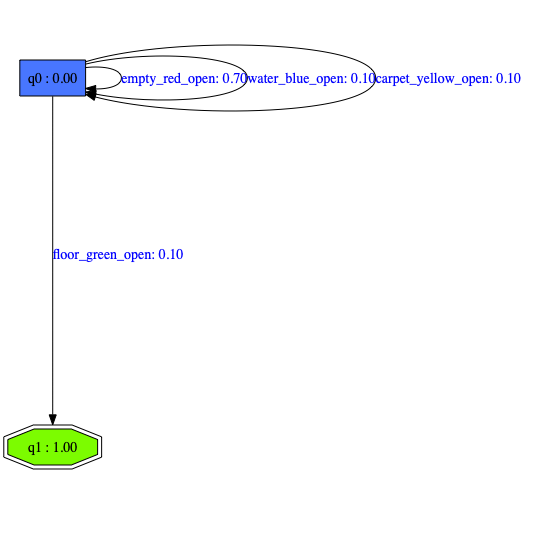

In [4]:
cosafe_specification = active_automata.get(automaton_type='PDFA',
                                           graph_data=PDFA_MODEL_CONFIG_FILE)

cosafe_specification.draw('_'.join([EXPERIMENT_NAME, ENV_ID_1, 'PDFA']))

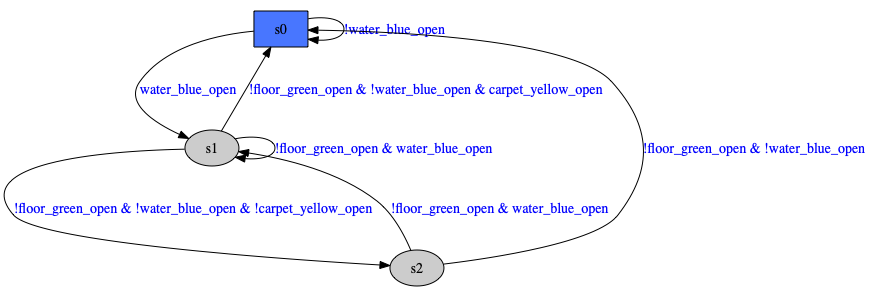

In [5]:
safe_specification = active_automata.get(automaton_type='DFA',
                                         graph_data=DFA_MODEL_CONFIG_FILE)
safe_specification.draw('_'.join([EXPERIMENT_NAME, ENV_ID_1, 'DFA']))

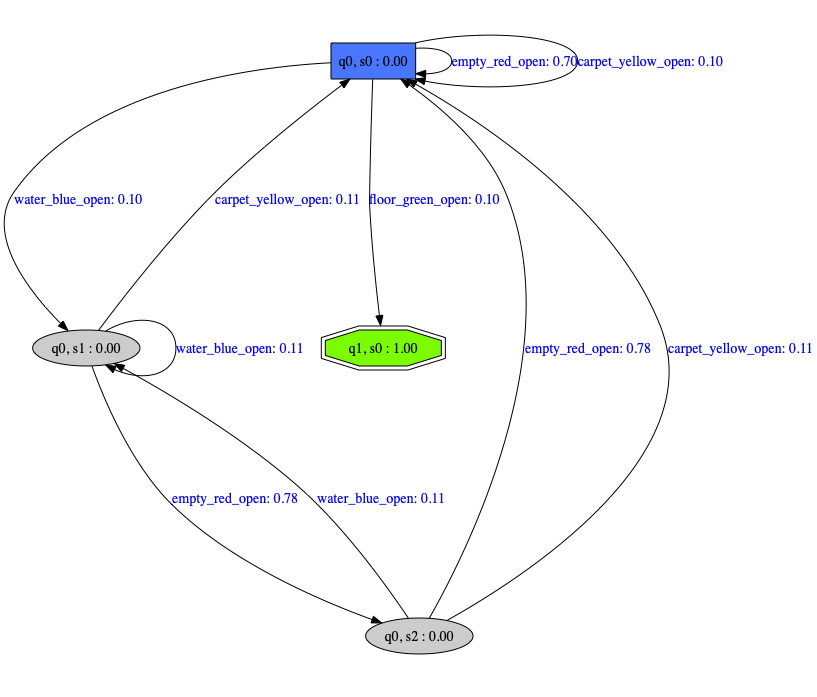

In [6]:
pdfa_specification = active_automata.get(automaton_type='PDFA',
                                         graph_data=(cosafe_specification,
                                                     safe_specification),
                                         graph_data_format='existing_objects',
                                         normalize_trans_probabilities=True)
pdfa_specification.draw('_'.join([EXPERIMENT_NAME, ENV_ID_1, 'PDFA', 'DFA']))

## Loading in the Simplified Transition System for Demonstration

We are going to demonstrate this specification using a simplified robot that can only go in each cardinal direction

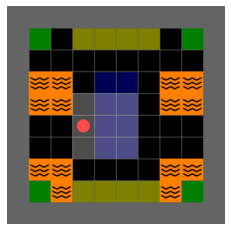

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)


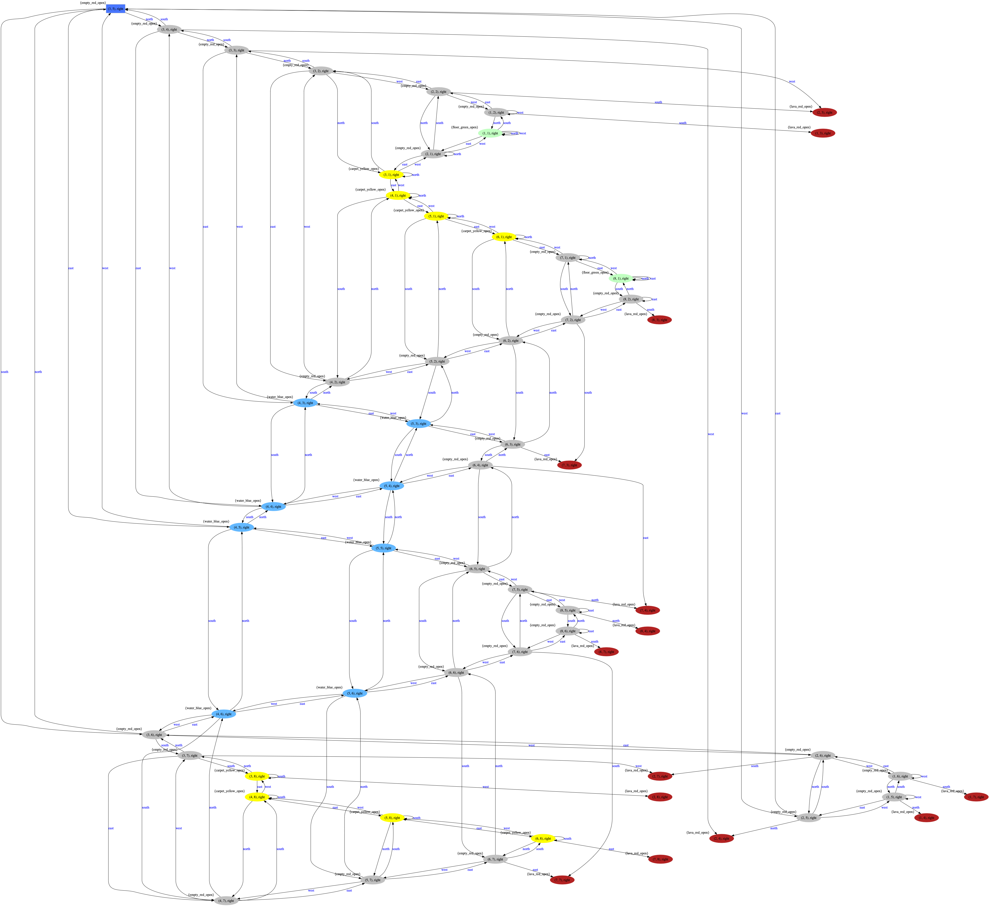

In [17]:
env = gym.make(ENV_ID_1)

env = StaticMinigridTSWrapper(env, actions_type='simple_static',
                              monitor_log_location=GYM_MONITOR_LOG_DIR)
env.reset()
env.render_notebook()

minigrid_TS = active_automata.get(automaton_type='TS', graph_data=env,
                                  graph_data_format='minigrid')
minigrid_TS.draw('_'.join([EXPERIMENT_NAME, ENV_ID_1, 'TS']))


In [18]:
minigrid_TS.observations

{'carpet_yellow_open',
 'empty_red_open',
 'floor_green_open',
 'lava_red_open',
 'water_blue_open'}

In [19]:
list(minigrid_TS.actions)

[<SimpleStaticActions.north: 0>,
 <SimpleStaticActions.south: 1>,
 <SimpleStaticActions.east: 2>,
 <SimpleStaticActions.west: 3>]

# Cosafety Specification Only Strategy

In [20]:
normalized_product = active_automata.get(automaton_type='Product',
                                         graph_data=(minigrid_TS,
                                                     cosafe_specification),
                                         normalize_trans_probabilities=True)
(MPS_controller,
 prob_of_controls_under_spec) = normalized_product.compute_strategy()

print('Minimum sampled string length:', len(MPS_controller))
print('Maximum trace probability:', prob_of_controls_under_spec)

output_string, visited_states, video_path = minigrid_TS.run(MPS_controller,
                                                            record_video=True)
print(output_string)
print(visited_states)
print('saving ... ', video_path)
Video(video_path, embed=True, html_attributes="controls muted autoplay loop")


Minimum sampled string length: 6
Maximum trace probability: 0.0004899500051015201
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
['(3, 5), right', '(3, 4), right', '(3, 3), right', '(3, 2), right', '(2, 2), right', '(1, 2), right', '(1, 1), right']
saving ...  /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/minigrid_env_logs/openaigym.video.28.13418.video000028.mp4


In [21]:
composed_product = active_automata.get(automaton_type='Product',
                                       graph_data=(minigrid_TS,
                                                   pdfa_specification),
                                       show_steps=False)

(MPS_controller,
 prob_of_controls_under_spec) = composed_product.compute_strategy()

print('Minimum sampled string length:', len(MPS_controller))
print('Maximum trace probability:', prob_of_controls_under_spec)

output_string, visited_states, video_path = minigrid_TS.run(MPS_controller,
                                                            record_video=True)
print(output_string)
print(visited_states)
print('saving ... ', video_path)
Video(video_path, embed=True, html_attributes="controls muted autoplay loop")


Minimum sampled string length: 6
Maximum trace probability: 0.01176490000000001
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
['(3, 5), right', '(3, 4), right', '(3, 3), right', '(3, 2), right', '(2, 2), right', '(2, 1), right', '(1, 1), right']
saving ...  /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/minigrid_env_logs/openaigym.video.29.13418.video000029.mp4


## Generating Correct System Demonstrations

Here, we are now going to sample behavioral demonstrations of the robot in its environment that adhere to the given specification.

### Giving the Demonstrations to the System

Here, we give the learner the EXACT same symbols as they would have gotten in the paper's 5 demonstrations. This is akin to demonstrating all of the most characteristic paths in the PDFA specification on the product's dynamics.

In [22]:
def eval_sampled_traces(traces, record_video=True):
    if traces is None:
        return
    
    output_strings = []
    for controls, length, prob in zip(*traces):
        if controls is None:
            continue
        output_string, _, video_path = minigrid_TS.run(
            controls,
            record_video=record_video,
            overwrite_old_video=record_video)
        output_strings.append(output_string)
        
        if record_video:
            print(pdfa_specification.cross_entropy_approx(output_string))
            print(prob)
            print(length)
        
        if record_video:
            v = Video(video_path, embed=True,
                      html_attributes="controls muted autoplay loop")
            display(v)
        
    return output_strings

In [23]:
a = minigrid_TS.actions
paper_controls = []
paper_controls.append([a.north, a.north, a.north, a.west, a.north, a.west])
paper_controls.append([a.north, a.north, a.north, a.north, a.west, a.west])
paper_controls.append([a.north, a.north, a.east, a.west, a.north, a.north, a.west, a.west])
paper_controls.append([a.north, a.east, a.north, a.north, a.north, a.west, a.west, a.west])
paper_controls.append([a.east, a.east, a.north, a.north, a.north, a.north, a.east, a.east, a.east])
paper_controls.append([a.east, a.north, a.north, a.west, a.north, a.east, a.east,
                      a.east, a.south, a.south, a.south, a.south, a.south,
                      a.west, a.west, a.west, a.north, a.north, a.north,
                      a.north, a.north, a.north, a.east, a.east, a.west, a.west,
                      a.south, a.east, a.east, a.east, a.east, a.north, a.east])
# paper_controls.append([a.north, a.north, a.east, a.west, a.north, a.west, a.north, a.west])

paper_samples = [(controls, len(controls), None) for controls in paper_controls]

paper_samples = eval_sampled_traces(zip(*paper_samples), record_video=True)

0.9156238759808444
None
6


1.3166745791319308
None
6


1.4165796816389484
None
8


2.023547098380077
None
8


2.403720071547556
None
9


1.2398138176750004
None
33


## Learning the Specification

Now that we have generated traces, we can create training / test data for learning with `flexfringe` and then for evaluating in `wombats`.

### Creating Training / Test Datasets

We need to learn a specification over state observations, not over control signals, so we use the ouput words from runs of the sampled controls on the original TS as the sampled traces to feed the learning algorithm:

In [24]:
traces = paper_samples

train_data_file = minigrid_TS.write_traces_to_file(
    traces,
    alphabet_size=minigrid_TS.alphabet_size,
    file=LEARNING_TRAIN_DATA_REL_FILEPATH)

In [25]:
print(DFA_MODEL_CONFIG_FILE)
print(os.path.abspath(DFA_MODEL_CONFIG_FILE))
print(minigrid_TS.automata_data_dir)
print(train_data_file)

wombats/config/DFA_merge_safety_to_seshia_paper.yaml
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/config/DFA_merge_safety_to_seshia_paper.yaml
experiments/merge_safety_to_seshia_paper
/Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train


### Learning with `Flexfringe`

In [26]:
flexfringe = FlexfringeInterface(output_directory=LEARNER_DATA_DIR)
flexfringe.infer_model(get_help=True)

no learning options specified, printing tool help:
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe --help  
Usage: flexfringe [OPTIONS]* [input dfa file]
      --version                          Display version information
  -V, --debug=integer                    Debug mode and verbosity evel
  -o, --output-dir=string                Relative path for output files with
                                         trailing /, default: "./".
  -h, --heuristic-name=string            Name of the merge heurstic to use;
                                         default count_driven. Use any
                                         heuristic in the evaluation
                                         directory. It is often beneficial to
                                         write your own, as heuristics are
                                         very application specific.
  -d, --data-name=string                 Name of the merge data class to use;
 

In [27]:
flexfringe.infer_model(training_file=train_data_file,
                       S=os.path.abspath(DFA_MODEL_CONFIG_FILE),  # comment to use vanilla, uncomment to check safety during merging
                       h='kldistance',
                       d='kl_data',
                       n='2',
                       x='0',
                       w='0',
                       b='1',
                       f='1',
                       I='0',
                       t='0', # 0=Merge when testing, 1=without merge (no actual merge is performed, only consistency and score are computed )
                       l='0',
                       q='0',
                       y='0',
                       p='2',
                       N='0',  # 1 to check Next (N) State
                       T='1',  # 1 to check Node Type (T)
                      )

# flexfringe.draw_initial_model()
# flexfringe.draw_learned_model()

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=/Users/kandai/Documents/projects/research/wombats_experiments/wombats/config/DFA_merge_safety_to_seshia_paper.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -p=2 -N=0 -T=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA wit

'// produced with flexfringe from git commitc8fad5bd3b0c0dad0e28ec7606f20a7fcf975071\n// dfasat/flexfringe -S=/Users/kandai/Documents/projects/research/wombats_experiments/wombats/config/DFA_merge_safety_to_seshia_paper.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -p=2 -N=0 -T=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train \ndigraph DFA {\n\t0 [label="root" shape=box];\n\t\tI -> 0;\n\t0 [ label="State No.0, #124"  ];\n\t\t0 -> 0 [label="empty_red_open:43,carpet_yellow_open:9"  ];\n\t\t0 -> 7 [label="floor_green_open:6"  ];\n\t\t0 -> 11 [label="water_blue_open:4"  ];\n\t7 [ label="State No.7, #6"  ];\n\t11 [ label="State No.11, #20"  ];\n\t\t11 -> 11 [label="water_blue_open:6"  ];\n\t\t11 -> 12 [label="empty_red_open:4"  ];\n\t12 [ label="State No.12, #8"  ];\n\t\t12 -> 0 

In [28]:
print('Output File: ', flexfringe.output_filepath)
print('Initial Model File: ', flexfringe.initial_model_filepath)
print('Learned Model File: ', flexfringe.learned_model_filepath)

Output File:  experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa
Initial Model File:  experiments/merge_safety_to_seshia_paper/flexfringe_data/dfainit_dfa.dot
Learned Model File:  experiments/merge_safety_to_seshia_paper/flexfringe_data/dfafinal.dot


In [29]:
# flexfringe.draw_initial_model()

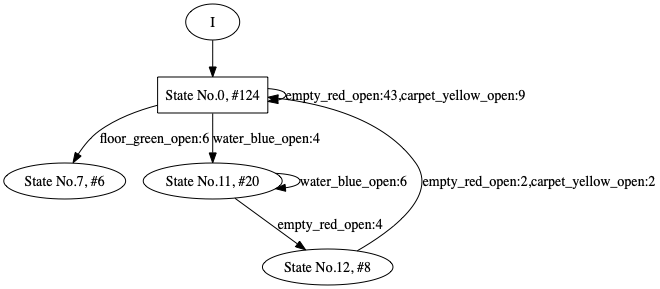

In [30]:
flexfringe.draw_learned_model()

In [31]:
dotfile_exist = True
ith_dotfile = 1

while dotfile_exist:
    try:
        filename = os.path.join(flexfringe._output_directory, "dfa_step%i.dot" % (ith_dotfile))
        print("Loading " + "%i th Steps' dot file" % (ith_dotfile) )
        flexfringe.draw_IPython(filename)
        ith_dotfile += 1
    except:
        dotfile_exist = False

Error: dfa_step1: syntax error in line 1 near 'None'


Loading 1 th Steps' dot file
No model file was found.


loading into `wombats`:

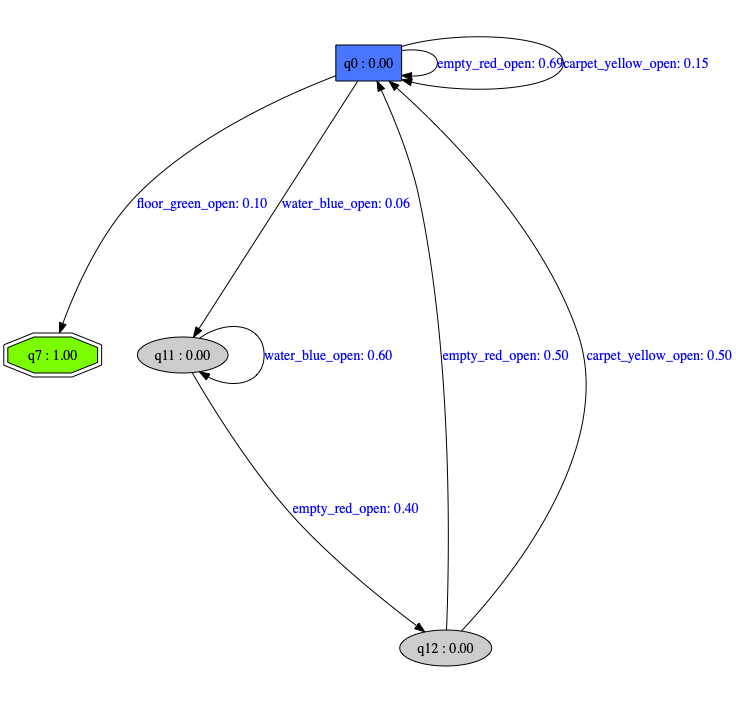

In [32]:
learned_fdfa = active_automata.get(automaton_type='FDFA',
                                   graph_data=flexfringe,
                                   graph_data_format='learning_interface')
learned_cosafe_pdfa = active_automata.get(automaton_type='PDFA',
                                   graph_data=learned_fdfa,
                                   graph_data_format='fdfa_object',
                                   merge_sinks=True)

learned_cosafe_pdfa.draw('_'.join([EXPERIMENT_NAME, ENV_ID_1, 'learned', 'PDFA']))

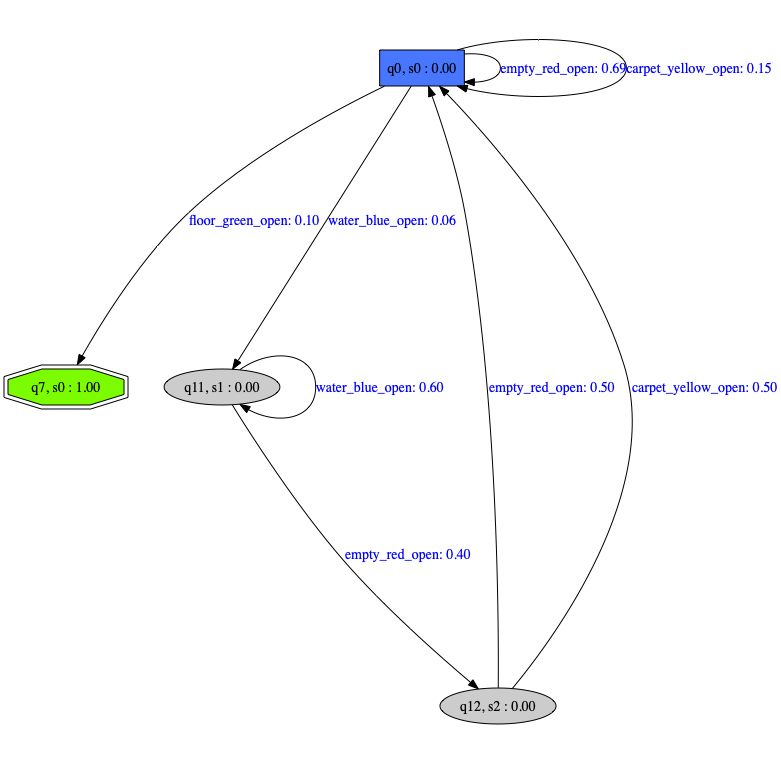

Target Score:  0.013594197319380013
Trained Score:  0.01312137316676823


In [33]:
learned_pdfa = active_automata.get(automaton_type='PDFA',
                                         graph_data=(learned_cosafe_pdfa,
                                                     safe_specification),
                                         graph_data_format='existing_objects',
                                         normalize_trans_probabilities=True)
learned_pdfa.draw('_'.join([EXPERIMENT_NAME, ENV_ID_1, 'PDFA', 'DFA']))

print('Target Score: ', sum([pdfa_specification.score(trace) for trace in traces]))
print('Trained Score: ', sum([learned_pdfa.score(trace) for trace in traces]))

## Computing the Most-Probable, Possible Controller

We see here that we get good results from this learning process. The learned specification has some limitations, for example in state `q9` it has no self-transition that would allow a robot in a different environment to make a jump of more than one cell from a carpet cell to a goal cell. This is not really a negative thing, as it is just as possible that we intended to inform the robot to only ever jump from a carpet cell to a goal cell if they're one cell apart.

using env: MiniGrid-LavaComparison_seshia-v0
using actions: simple_static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)


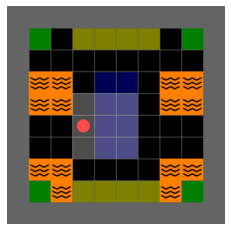

underlying transition system


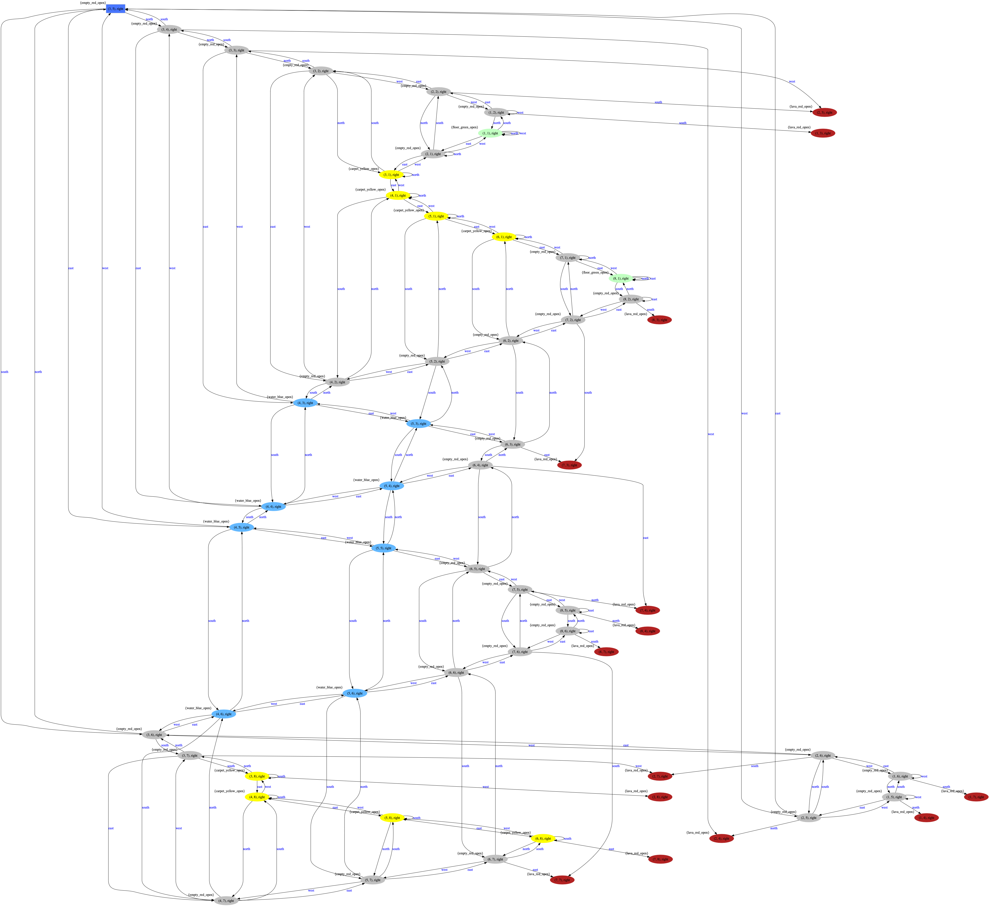

product automaton


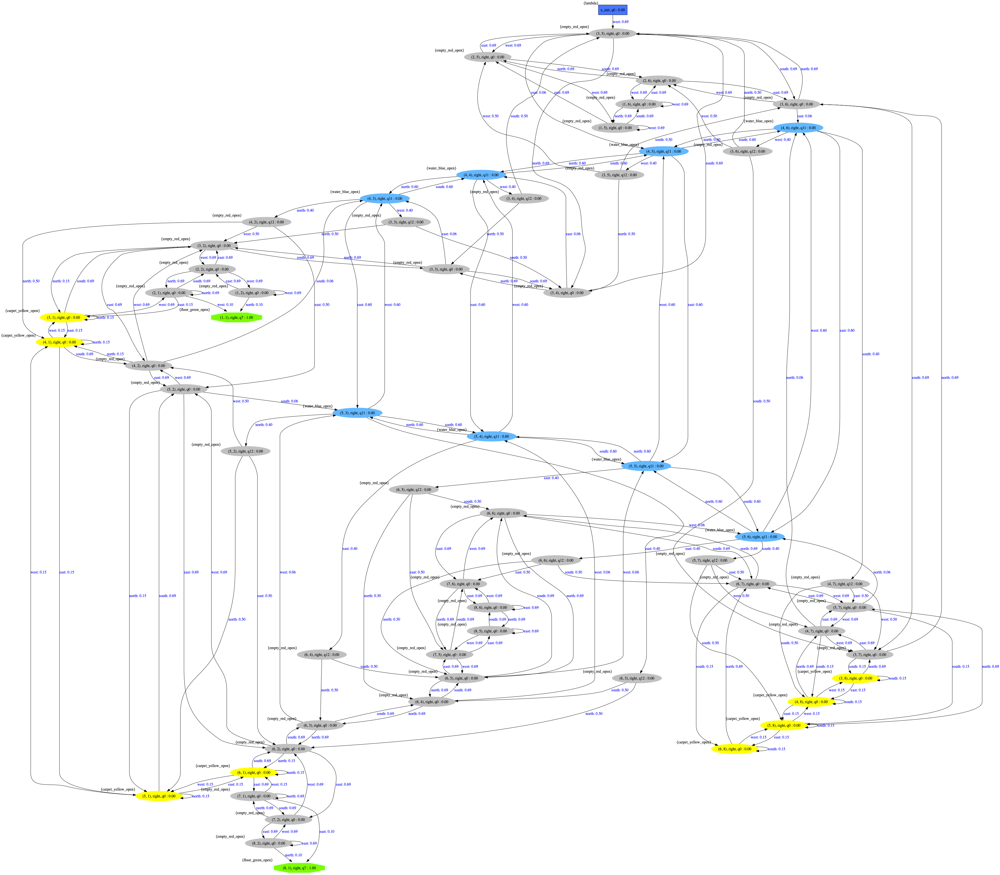


Optimal Controls: ['north', 'north', 'north', 'west', 'north', 'west']
Probability of Generated TS Observations in Spec: 0.010770110456476177
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
['(3, 5), right', '(3, 4), right', '(3, 3), right', '(3, 2), right', '(2, 2), right', '(2, 1), right', '(1, 1), right']


using env: MiniGrid-LavaComparison_seshia-v0
using actions: simple_static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)


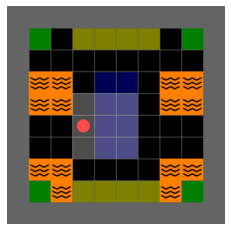

underlying transition system


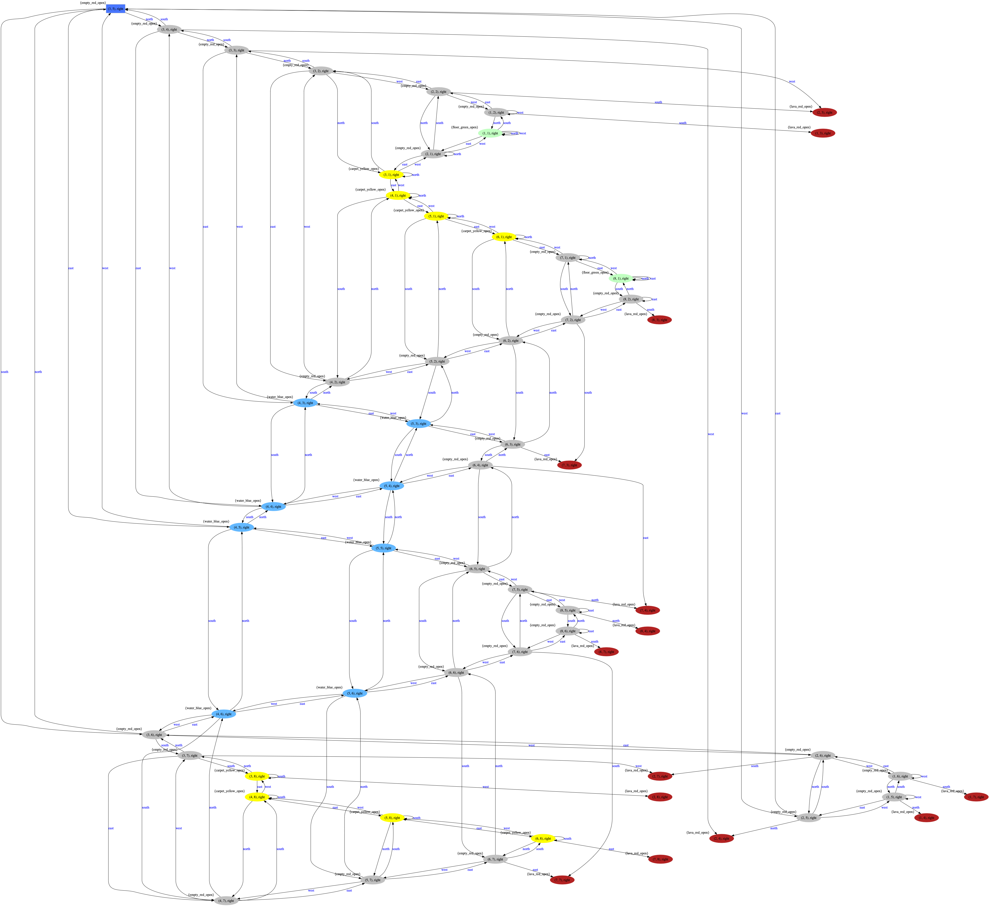

product automaton


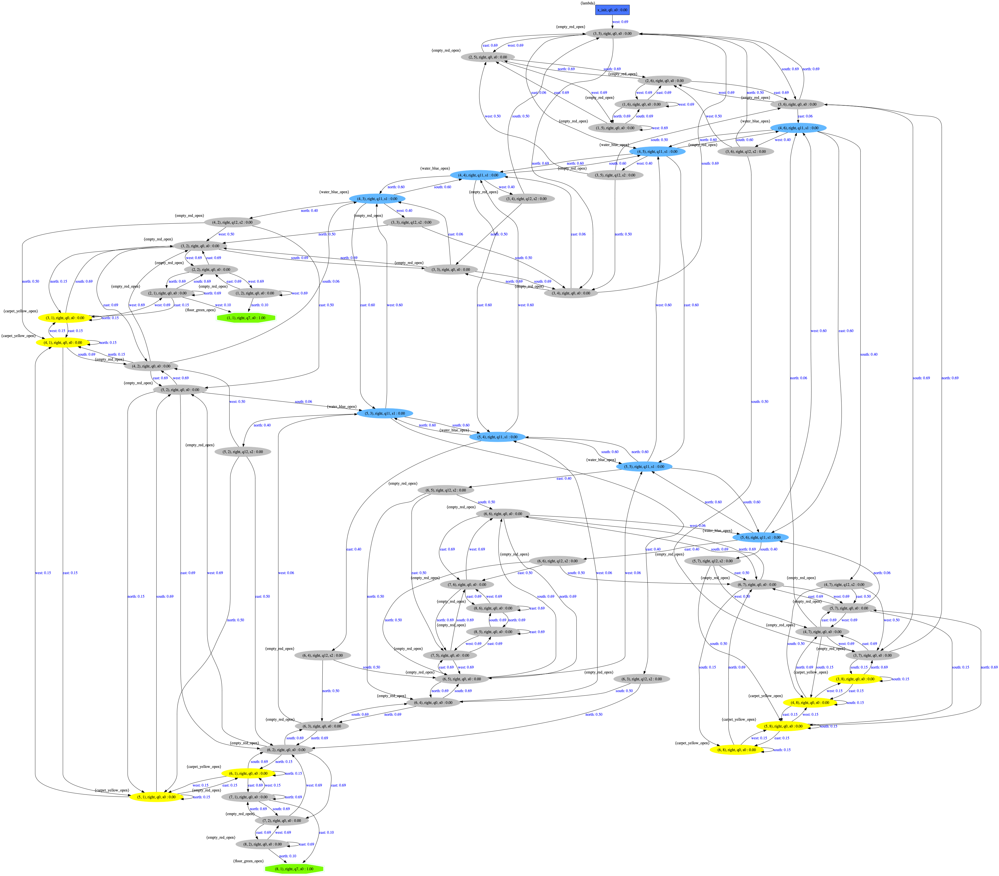


Optimal Controls: ['north', 'north', 'north', 'west', 'north', 'west']
Probability of Generated TS Observations in Spec: 0.010770110456476177
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
['(3, 5), right', '(3, 4), right', '(3, 3), right', '(3, 2), right', '(2, 2), right', '(2, 1), right', '(1, 1), right']


In [34]:
def solve_environment(specification, ENV_ID, actions_type='simple_static',
                      show_figures=False, record_video=True):
    
    print('using env:', ENV_ID)
    print('using actions:', actions_type)

    env = gym.make(ENV_ID)
    env = StaticMinigridTSWrapper(env, actions_type=actions_type,
                                  monitor_log_location=GYM_MONITOR_LOG_DIR)
    env.reset()
    
    TS = active_automata.get(automaton_type='TS', graph_data=env,
                             graph_data_format='minigrid')

    if show_figures:
        env.render_notebook()
        print('underlying transition system')
        TS.draw('_'.join([EXPERIMENT_NAME, ENV_ID_1, 'TS']))

    product = active_automata.get(automaton_type='Product',
                                  graph_data=(TS, specification))
    if show_figures:
        print('product automaton')
        product.draw('_'.join([EXPERIMENT_NAME, ENV_ID, 'learned', 'product']))

    (controls,
     prob_of_controls_under_spec) = product.compute_strategy()

    print(f'Optimal Controls: {controls}')
    print(f'Probability of Generated TS Observations in Spec: ' +
          f'{prob_of_controls_under_spec}')
    
    (output_string,
     visited_states,
     video_path) = TS.run(controls, record_video=record_video)
    
    print(output_string)
    print(visited_states)
    if record_video:
        v = Video(video_path, embed=True,
                  html_attributes="controls muted autoplay loop")
        display(v)
        
solve_environment(learned_cosafe_pdfa, ENV_ID_1, show_figures=True)
solve_environment(learned_pdfa, ENV_ID_1, show_figures=True)

## Trying out the Specification with Different Environments / Robots

Here, we want to show that the specification we learned has a lot of generalization power, and captures the appropriate task for a large variety of different robots .

The learning environment, but with lava added to block the routes between the lava and the water, forcing the robot to go through the water if it wishes to complete the task.

In [35]:
solve_environment(learned_cosafe_pdfa, ENV_ID_2)
solve_environment(learned_pdfa, ENV_ID_2)

using env: MiniGrid-LavaComparison_SeshiaOnlyWaterPath-v0
using actions: simple_static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['south', 'south', 'east', 'east', 'south', 'east', 'east', 'east']
Probability of Generated TS Observations in Spec: 0.00022694561575821296
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']
['(3, 5), right', '(3, 6), right', '(3, 7), right', '(4, 7), right', '(5, 7), right', '(5, 8), right', '(6, 8), right', '(7, 8), right', '(8, 8), right']


using env: MiniGrid-LavaComparison_SeshiaOnlyWaterPath-v0
using actions: simple_static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['south', 'south', 'east', 'east', 'south', 'east', 'east', 'east']
Probability of Generated TS Observations in Spec: 0.00022694561575821296
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']
['(3, 5), right', '(3, 6), right', '(3, 7), right', '(4, 7), right', '(5, 7), right', '(5, 8), right', '(6, 8), right', '(7, 8), right', '(8, 8), right']


Now, what if have a completely different robot try to accomplish the same task in the same two environments? We should compute a *different* sequence of actions for it to make that match the same task specification.

In [36]:
solve_environment(learned_cosafe_pdfa, ENV_ID_1, actions_type='static')
solve_environment(learned_cosafe_pdfa, ENV_ID_2, actions_type='static')
solve_environment(learned_cosafe_pdfa, ENV_ID_1, actions_type='diag_static')
solve_environment(learned_cosafe_pdfa, ENV_ID_2, actions_type='diag_static')

using env: MiniGrid-LavaComparison_seshia-v0
using actions: static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['left', 'forward', 'forward', 'forward', 'left', 'forward', 'forward', 'right', 'forward']
Probability of Generated TS Observations in Spec: 0.0035929440605512223
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
['(3, 5), right', '(3, 5), up', '(3, 4), up', '(3, 3), up', '(3, 2), up', '(3, 2), left', '(2, 2), left', '(1, 2), left', '(1, 2), up', '(1, 1), up']


using env: MiniGrid-LavaComparison_SeshiaOnlyWaterPath-v0
using actions: static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['forward', 'forward', 'forward', 'forward', 'forward', 'right', 'forward', 'forward', 'forward']
Probability of Generated TS Observations in Spec: 0.00012022448881647823
['empty_red_open', 'water_blue_open', 'water_blue_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
['(3, 5), right', '(4, 5), right', '(5, 5), right', '(6, 5), right', '(7, 5), right', '(8, 5), right', '(8, 5), down', '(8, 6), down', '(8, 7), down', '(8, 8), down']


using env: MiniGrid-LavaComparison_seshia-v0
using actions: diag_static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['northeast', 'northwest', 'northwest', 'northwest']
Probability of Generated TS Observations in Spec: 0.0008660333657816119
['empty_red_open', 'water_blue_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
['(3, 5), right', '(4, 4), right', '(3, 3), right', '(2, 2), right', '(1, 1), right']


using env: MiniGrid-LavaComparison_SeshiaOnlyWaterPath-v0
using actions: diag_static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['southwest', 'southeast', 'southeast', 'northeast', 'northeast', 'southeast', 'southeast']
Probability of Generated TS Observations in Spec: 0.0015634031307788
['empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
['(3, 5), right', '(2, 6), right', '(3, 7), right', '(4, 8), right', '(5, 7), right', '(6, 6), right', '(7, 7), right', '(8, 8), right']


In [37]:
solve_environment(learned_pdfa, ENV_ID_1, actions_type='static')
solve_environment(learned_pdfa, ENV_ID_2, actions_type='static')
solve_environment(learned_pdfa, ENV_ID_1, actions_type='diag_static')
solve_environment(learned_pdfa, ENV_ID_2, actions_type='diag_static')

using env: MiniGrid-LavaComparison_seshia-v0
using actions: static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['left', 'forward', 'forward', 'forward', 'left', 'forward', 'forward', 'right', 'forward']
Probability of Generated TS Observations in Spec: 0.0035929440605512223
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
['(3, 5), right', '(3, 5), up', '(3, 4), up', '(3, 3), up', '(3, 2), up', '(3, 2), left', '(2, 2), left', '(1, 2), left', '(1, 2), up', '(1, 1), up']


using env: MiniGrid-LavaComparison_SeshiaOnlyWaterPath-v0
using actions: static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['forward', 'forward', 'forward', 'forward', 'forward', 'right', 'forward', 'forward', 'forward']
Probability of Generated TS Observations in Spec: 0.00012022448881647823
['empty_red_open', 'water_blue_open', 'water_blue_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
['(3, 5), right', '(4, 5), right', '(5, 5), right', '(6, 5), right', '(7, 5), right', '(8, 5), right', '(8, 5), down', '(8, 6), down', '(8, 7), down', '(8, 8), down']


using env: MiniGrid-LavaComparison_seshia-v0
using actions: diag_static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['northeast', 'northwest', 'northwest', 'northwest']
Probability of Generated TS Observations in Spec: 0.0008660333657816119
['empty_red_open', 'water_blue_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
['(3, 5), right', '(4, 4), right', '(3, 3), right', '(2, 2), right', '(1, 1), right']


using env: MiniGrid-LavaComparison_SeshiaOnlyWaterPath-v0
using actions: diag_static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['southwest', 'southeast', 'southeast', 'northeast', 'northeast', 'southeast', 'southeast']
Probability of Generated TS Observations in Spec: 0.0015634031307788
['empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
['(3, 5), right', '(2, 6), right', '(3, 7), right', '(4, 8), right', '(5, 7), right', '(6, 6), right', '(7, 7), right', '(8, 8), right']


Now, let's try this specification on a completely different environment, with a completely different goal, with all the different robots:

In [38]:
all_actions_types = ['simple_static', 'static', 'diag_static']

all_experiments = itertools.product(new_env_IDs, all_actions_types)

for env_ID, actions_type in all_experiments:
    solve_environment(learned_cosafe_pdfa, env_ID, actions_type=actions_type)

using env: MiniGrid-AlternateLavaComparison_AllCorridorsOpen_Wide-v0
using actions: simple_static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['east', 'east', 'east', 'north', 'north', 'north', 'north', 'north', 'north', 'north', 'north', 'north', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'south', 'south', 'south', 'south', 'south', 'east', 'south', 'south', 'south', 'south']
Probability of Generated TS Observations in Spec: 3.8226946404178473e-07
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'flo

using env: MiniGrid-AlternateLavaComparison_AllCorridorsOpen_Wide-v0
using actions: static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['forward', 'forward', 'forward', 'left', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'right', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'right', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'left', 'forward']
Probability of Generated TS Observations in Spec: 8.844568950892277e-08
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_op

using env: MiniGrid-AlternateLavaComparison_AllCorridorsOpen_Wide-v0
using actions: diag_static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['northeast', 'northeast', 'northeast', 'northwest', 'northeast', 'northwest', 'northeast', 'northwest', 'northeast', 'northeast', 'southeast', 'northeast', 'southeast', 'northeast', 'southeast', 'northeast', 'southeast', 'northeast', 'southeast', 'northeast', 'southeast', 'southeast', 'southwest', 'southeast', 'southwest', 'southeast', 'southwest', 'southeast', 'southwest', 'southeast']
Probability of Generated TS Observations in Spec: 1.6521997165735375e-06
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_o

using env: MiniGrid-AlternateLavaComparison_OnlyWaterPath_Wide-v0
using actions: simple_static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['east', 'north', 'north', 'east', 'north', 'north', 'east', 'north', 'north', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'south', 'south', 'south', 'west', 'west', 'west', 'west', 'west', 'west', 'south', 'south', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'south']
Probability of Generated TS Observations in Spec: 4.397038932051833e-11
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_ope

using env: MiniGrid-AlternateLavaComparison_OnlyWaterPath_Wide-v0
using actions: static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['forward', 'forward', 'forward', 'left', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'right', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'right', 'forward', 'forward', 'forward', 'right', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'left', 'forward', 'forward', 'forward', 'left', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward']
Probability of Generated TS Observations in Spec: 2.371337280052108e-12
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blu

using env: MiniGrid-AlternateLavaComparison_OnlyWaterPath_Wide-v0
using actions: diag_static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['northeast', 'northeast', 'northeast', 'northwest', 'northeast', 'northeast', 'northeast', 'southeast', 'northeast', 'southeast', 'northeast', 'southeast', 'northeast', 'southeast', 'southeast', 'southwest', 'southwest', 'northwest', 'southwest', 'northwest', 'southwest', 'southwest', 'southeast', 'southeast', 'northeast', 'southeast', 'northeast', 'southeast', 'northeast', 'southeast', 'northeast', 'southeast']
Probability of Generated TS Observations in Spec: 1.2685942231131088e-09
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'w

In [39]:
all_actions_types = ['simple_static', 'static', 'diag_static']

all_experiments = itertools.product(new_env_IDs, all_actions_types)

for env_ID, actions_type in all_experiments:
    solve_environment(learned_pdfa, env_ID, actions_type=actions_type)

using env: MiniGrid-AlternateLavaComparison_AllCorridorsOpen_Wide-v0
using actions: simple_static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['east', 'east', 'east', 'north', 'north', 'north', 'north', 'north', 'north', 'north', 'north', 'north', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'south', 'south', 'south', 'south', 'south', 'east', 'south', 'south', 'south', 'south']
Probability of Generated TS Observations in Spec: 3.8226946404178473e-07
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'flo

using env: MiniGrid-AlternateLavaComparison_AllCorridorsOpen_Wide-v0
using actions: static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['forward', 'forward', 'forward', 'left', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'right', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'right', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'left', 'forward']
Probability of Generated TS Observations in Spec: 8.844568950892277e-08
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_op

using env: MiniGrid-AlternateLavaComparison_AllCorridorsOpen_Wide-v0
using actions: diag_static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['northeast', 'northeast', 'northeast', 'northwest', 'northeast', 'northwest', 'northeast', 'northwest', 'northeast', 'northeast', 'southeast', 'northeast', 'southeast', 'northeast', 'southeast', 'northeast', 'southeast', 'northeast', 'southeast', 'northeast', 'southeast', 'southeast', 'southwest', 'southeast', 'southwest', 'southeast', 'southwest', 'southeast', 'southwest', 'southeast']
Probability of Generated TS Observations in Spec: 1.6521997165735375e-06
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_o

using env: MiniGrid-AlternateLavaComparison_OnlyWaterPath_Wide-v0
using actions: simple_static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['east', 'north', 'north', 'east', 'north', 'north', 'east', 'north', 'north', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'south', 'south', 'south', 'west', 'west', 'west', 'west', 'west', 'west', 'south', 'south', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'south']
Probability of Generated TS Observations in Spec: 4.397038932051833e-11
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_ope

using env: MiniGrid-AlternateLavaComparison_OnlyWaterPath_Wide-v0
using actions: static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['forward', 'forward', 'forward', 'left', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'right', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'right', 'forward', 'forward', 'forward', 'right', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'left', 'forward', 'forward', 'forward', 'left', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward']
Probability of Generated TS Observations in Spec: 2.371337280052108e-12
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blu

using env: MiniGrid-AlternateLavaComparison_OnlyWaterPath_Wide-v0
using actions: diag_static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['northeast', 'northeast', 'northeast', 'northwest', 'northeast', 'northeast', 'northeast', 'southeast', 'northeast', 'southeast', 'northeast', 'southeast', 'northeast', 'southeast', 'southeast', 'southwest', 'southwest', 'northwest', 'southwest', 'northwest', 'southwest', 'southwest', 'southeast', 'southeast', 'northeast', 'southeast', 'northeast', 'southeast', 'northeast', 'southeast', 'northeast', 'southeast']
Probability of Generated TS Observations in Spec: 1.2685942231131088e-09
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'w

# Compare 3 Types of Learning Methods
## 1. Standard Specification Learning
## 2. Postprocessing Safety
## 3. Embedding Safety


In [40]:
from wombats.automaton import DFA, PDFA, TransitionSystem
from abc import ABCMeta, abstractmethod

class SpecificationLearning(metaclass=ABCMeta):
    kwargs = {'h': 'kldistance',
              'd': 'kl_data',
              'n': '2',
              'x': '0',
              'w': '0',
              'b': '1',
              'f': '1',
              'I': '0',
              't': '0',
              'l': '0',
              'q': '0',
              'y': '0',
              'N': '0',
              'T': '1',
              'p': '1'}
    
    def __init__(self):
        self.elapsed_time = 0.0
    
    def _update_params(self, **kwargs):
        self.kwargs.update(kwargs)

    @abstractmethod
    def learn(self, train_data_file: str, safe_specification: DFA, **kwargs) -> PDFA:
        """
        :return PDFA: Learned PDFA
        """
        raise NotImplementedError


class VanillaSpecificationLearning(SpecificationLearning):
    def learn(self, train_data_file: str, safe_specification: DFA, **kwargs) -> PDFA:
        self._update_params(**kwargs)
        flexfringe = FlexfringeInterface(output_directory=LEARNER_DATA_DIR)
        data = flexfringe.infer_model(training_file=train_data_file, record_time=True, **self.kwargs)
        fdfa = active_automata.get(automaton_type='FDFA',
                                   graph_data=flexfringe,
                                   graph_data_format='learning_interface')
        specification = active_automata.get(automaton_type='PDFA',
                                            graph_data=fdfa,
                                            graph_data_format='fdfa_object',
                                            merge_sinks=True)
        self.elapsed_time = flexfringe.average_elapsed_time

        return specification


class PostprocessingSpecificationLearning(SpecificationLearning):
    def learn(self, train_data_file: str, safe_specification: DFA, **kwargs) -> PDFA:
        self._update_params(**kwargs)
        flexfringe = FlexfringeInterface(output_directory=LEARNER_DATA_DIR)
        data = flexfringe.infer_model(training_file=train_data_file, record_time=True, **self.kwargs)
        fdfa = active_automata.get(automaton_type='FDFA',
                                   graph_data=flexfringe,
                                   graph_data_format='learning_interface')
        specification = active_automata.get(automaton_type='PDFA',
                                            graph_data=fdfa,
                                            graph_data_format='fdfa_object',
                                            merge_sinks=True)
        # Postprocessing Safety
        product = active_automata.get(automaton_type='PDFA',
                                      graph_data=(specification,
                                                  safe_specification),
                                      graph_data_format='existing_objects',
                                      normalize_trans_probabilities=True,
                                      delete_sinks=False)
        self.elapsed_time = flexfringe.average_elapsed_time

        return product


class EmbeddingSpecificationLearning(SpecificationLearning):
    def learn(self, train_data_file: str, safe_specification: DFA, **kwargs) -> PDFA:
        self._update_params(**kwargs)
        flexfringe = FlexfringeInterface(output_directory=LEARNER_DATA_DIR)
        p = Path(DFA_MODEL_CONFIG_FILE)
        DFA_MODEL_CONFIG_FILE2 = os.path.join(p.parent, p.stem + '_twogoals' + p.suffix)
        # Embedding Safety during the learning process
        data = flexfringe.infer_model(training_file=train_data_file, 
                                      S=safe_specification.graph_data_file,
                                      record_time=True,
                                      **self.kwargs)
        fdfa = active_automata.get(automaton_type='FDFA',
                                   graph_data=flexfringe,
                                   graph_data_format='learning_interface')
        specification = active_automata.get(automaton_type='PDFA',
                                            graph_data=fdfa,
                                            graph_data_format='fdfa_object',
                                            merge_sinks=True)
        self.elapsed_time = flexfringe.average_elapsed_time
        return specification

In [41]:
def generate_training_data_from_originial_pdfa(pdfa_specification, 
                                               num_samples=1000, 
                                               max_trace_length=20, 
                                               test_size=0.2):
    """
    :param pdfa_specification:      A manually specified PDFA specification Automaton
    :param num_samples:             No. of samples
    :param max_trace_length:        Maximum Trace Length
    :param test_size:               Test size [0, 1]
    """
    (traces,
     trace_lengths,
     trace_probs) = pdfa_specification.generate_traces(num_samples, N=max_trace_length)

    # create a training-test split for model validation after training 
    (traces_train, traces_test,
     traceLengths_train, traceLengths_test,
     trace_probs_train, trace_probs_test) = train_test_split(traces,
                                                             trace_lengths,
                                                             trace_probs,
                                                             test_size=test_size)

    # Write learning data to files for inference
    train_data_file = pdfa_specification.write_traces_to_file(
        traces_train,
        alphabet_size=pdfa_specification.alphabet_size,
        file=LEARNING_TRAIN_DATA_REL_FILEPATH)
    test_data_file = pdfa_specification.write_traces_to_file(
        traces_test,
        alphabet_size=pdfa_specification.alphabet_size,
        file=LEARNING_TEST_DATA_REL_FILEPATH) 
    
    return train_data_file, test_data_file, traces_train, traces_test, trace_probs_train, trace_probs_test

In [42]:
def evaluate_pdfa_specification(pdfa_specification, minigrid_TS, learner, safe_specification, traces_test, trace_probs_test):
    """
    :param pdfa_specification:      A manually specified PDFA specification Automaton
    :param minigrid_TS:             A TransitionSystem Automaton
    :param num_samples:             No. of samples
    :param max_trace_length:        Maximum Trace Length
    :param test_size:               Test size [0, 1]
    
    :return result: A dict of results
    """
    num_node = len(list(pdfa_specification.nodes.keys()))
    num_edge = len(list(pdfa_specification.edges.keys()))
    MPS, MPS_prob, _ = pdfa_specification.most_probable_string()
    perplexity = pdfa_specification.perplexity(traces_test, trace_probs_test, ignore_reject_trace=False)
    sum_probs = sum([pdfa_specification.score(t) for t in traces_test])
    average_norm = pdfa_specification.average_norm(traces_test, trace_probs_test)
    safe = safe_specification.is_safe(pdfa_specification)
    elapsed_time = 0 if learner is None else learner.elapsed_time
    
    merged_product = active_automata.get(automaton_type='Product',
                                     graph_data=(minigrid_TS, 
                                                 pdfa_specification),
                                     show_steps=False)
    num_node_in_prod = len(list(merged_product.nodes.keys()))
    num_edge_in_prod = len(list(merged_product.edges.keys()))
    
    print('computing strategy ...')
    (MPS_controller, 
     prob_of_controls_under_spec) = merged_product.compute_strategy()
    print('computed controller: ', MPS_controller)
    output_string, visited_states, video_path = minigrid_TS.run(MPS_controller,
                                                                record_video=False)
    print('runs: ', output_string)
    
    return {'No. of Nodes in the Specification PDFA': num_node, 
            'No. of Edges Per Node': num_edge / num_node, 
#             'No. of Nodes in the Product': num_node_in_prod,
#             'No. of Edges in the Product': num_edge_in_prod,
            'Shortest Path Length': len(output_string),
            'Output String': output_string,
            'Perplexity': perplexity,
            'Sum of Probabilities': sum_probs,
#             'True Sum of Probabilities': sum(trace_probs_test),
            'Average L2 Norm': average_norm,
            'Elapsed Time': elapsed_time,
            'Safe': int(safe)}

In [43]:
def run_learners(learners: {str, SpecificationLearning}, 
                 safe_specification: DFA, 
                 minigrid_TS: TransitionSystem, 
                 pdfa_specification: PDFA, 
                 num_samples=1000, 
                 max_trace_length=20, 
                 test_size=0.2, 
                 **kwargs):
    """
    Run a sequence of following steps
    1. Generate Training traces
    2. Learn a PDFA Specification from SpecificationLearning Algorithm
    3. Evaluate the learned PDFAs
                                    
    :param learners:                A dict of Specificationlearning Algorithm
    :param safe_specification:      A Safety DFA Automaton
    :param minigrid_TS:             A TransitionSystem Automaton
    :param pdfa_specification:      A manually specified PDFA specification Automaton
    :param num_samples:             No. of samples
    :param max_trace_length:        Maximum Trace Length
    :param test_size:               Test size [0, 1]
    
    :return pdfas: A dict of PDFAs including target and trained specifications {str, PDFA}
    :return results: A dict results including target and trained results {str, result} where result is a dict
    """
    print('generating traces')
    # Generate Training Data
    (train_data_file,
     test_data_file, 
     traces_train, 
     traces_test,
     trace_probs_train, 
     trace_probs_test) = generate_training_data_from_originial_pdfa(pdfa_specification, 
                                                               num_samples, 
                                                               max_trace_length, 
                                                               test_size)
    
    print('started learning ...')

    # Learn Specification given the chosen algorithm
    pdfas = {'target': pdfa_specification}
    for name, learner in learners.items():
        print('learning pdfa using ' + name)
        pdfa = learner.learn(train_data_file, safe_specification, **kwargs)
        pdfas[name] = pdfa
        
    print('evaluating ...')
    # Evaluate the learned PDFA
    results = {}
    for name, pdfa in pdfas.items():
        learner = learners[name] if name in learners else None
        result = evaluate_pdfa_specification(pdfa, minigrid_TS, learner, safe_specification, traces_test, trace_probs_test)
        results[name] = result
    
    return {'pdfas': pdfas, 'results': results}

def run_learner(learner_name, learner, **kwargs):
    return run_learners({learner_name: learner}, **kwargs)

In [44]:
def plot_selected_results(experiments, 
                          params: {str, list}, 
                          selected_params: {str, float},
                          figsize=(8, 6)):
    xkeylist = list(set(params)-set(selected_params))
    if len(xkeylist) != 1:
        raise ValueError('No. of Selected Params must be = No. of Params - 1 ')
    
    # An array for the x axis
    xkey = xkeylist[0]
    X = params[xkey]
    
    try:
        experiment = list(experiments.values())[0]['results']
        pdfa_names = list(experiment.keys())
        result = list(experiment.values())[0]
        metrics = {k: type(v) for k, v in result.items()}
    except:
        raise ValueError("Could not parse 'experiments' dict correctly")
    
    Ymetric = {}
    for metric, valuetype in metrics.items():
        if valuetype not in [int, float]:
            continue
        Ymetric[metric] = {}
        for pdfa_name in pdfa_names:
            Ymetric[metric][pdfa_name] = []
    keydict = {n: selected_params[n] if n in selected_params else 0 for n in params.keys()}
    
    for x in X:
        keydict[xkey] = x
        key = tuple(keydict.values())
        experiment = experiments[key]
        
        for pdfa_name, result in experiment['results'].items():
            for metric, value in result.items():
                if type(value) not in [int, float]:
                    continue
                Ymetric[metric][pdfa_name].append(value)
    
    for metric, Ypdfa in Ymetric.items():
        plt.figure(figsize=figsize)
        for pdfa_name, Y in Ypdfa.items():
            kwargs = {'marker': 'o'} if pdfa_name=='target' else {}
            plt.plot(X, Y, label=pdfa_name, **kwargs)
        plt.title(metric)
        plt.grid()
        plt.xlabel(xkey.replace('_', ' '))
        plt.legend()
        if metric == 'Average L2 Norm': plt.yscale('log')
        plt.xscale('log')

In [45]:
def draw_selected_pdfa(experiments,
                       params: {str, list},
                       selected_params: {str, float},
                       pdfa_name: str):
    xkeylist = list(set(params)-set(selected_params))
    if len(xkeylist) != 0:
        raise ValueError('No. of Selected Params must be equal to No. of Params')
    
    key = tuple(selected_params.values())
    experiment = experiments[key]
    pdfa = experiment['pdfas'][pdfa_name]
    pdfa.draw('_'.join([EXPERIMENT_NAME, pdfa_name]))

# Runs all the experiments

In [46]:
# Parameters that we want to observe
num_samples = np.logspace(1, 3, num=100)
p = ['0.6', '1', '2', '5']
# N = ['0', '1']

# Keys should match with the run_learners argument names
params = {'num_samples': num_samples,
#           'N': N,
          'p': p,
          }

# Products of all the parameters defined above
all_params = itertools.product(*params.values())

# Define an experiment function with default parameters
learners = {'vanilla': VanillaSpecificationLearning(),
            'postprocess': PostprocessingSpecificationLearning(),
            'embedding': EmbeddingSpecificationLearning()}

run_experiment = lambda **kwargs: run_learners(learners=learners, 
                                               safe_specification=safe_specification, 
                                               minigrid_TS=minigrid_TS,
                                               pdfa_specification=pdfa_specification, 
                                               **kwargs)

# experiments is a dict {(tuple of parameter values), (tuple of pdfas, results)}
experiments = {}

# Run each experiment
for each_params in all_params:
    kwargs = dict(zip(params.keys(), each_params))
    experiments[each_params] = run_experiment(**kwargs)

generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99959 m99988 x8 m99988 m99943 x4


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q15) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:230: RuntimeWarning: divide by zero encountered in log
  return np.asscalar(np.log(score) / np.log(base))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q15, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q17) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q15) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q15, s1) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q21) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q32) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q26) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q26, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q33) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q9) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q9, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q10) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q0, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q35) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q43) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q38) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q43, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q38, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q53) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_dr


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q54) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q54, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q54) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q74) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q45) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q18) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q74, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q45, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q18, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q67) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q72) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q5) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q34) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q12) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q73) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q2) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q0, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q2) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q2, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q40) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q37) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q37, s2) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q37) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q60) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q56) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q56) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q56, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q56, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q59) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q49) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q47) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q13) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q13, s1) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q64) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q64, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q22) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q42) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q73) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q73, s1) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q32) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q25) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q25) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q64) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q12) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q58) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q30) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q49) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q30, s2) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q49, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q4) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q24) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q71) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q71) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q71, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q71, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q114) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q20) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q43) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q19) transition distribution
  warnings.warn(str(e))



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q22) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q28) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q28, s1) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q81) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q44) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q29) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['south', 'north', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q25) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q69) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q11) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q13) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q30) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q23) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q30, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q23, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q96) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q84) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q138) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q138, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q46) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q111) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q111, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q0, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q24) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q101) transition distribution
  warnings.warn(str(e))



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q142) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q142, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q139) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q107) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q139, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q107, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q70) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q70, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q90) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q191) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q30, s1) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q30, s2) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q194) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q276) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q194, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q276, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q178) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q66) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q66, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q153) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q221) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q221, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q120) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q118) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q118, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q61) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q21) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q90) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q29) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q115) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q29, s1) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q115, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q55) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q215) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q146) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q147) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q146, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q147, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q140) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q96) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q100) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q100, s2) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q100, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q100, s1) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q29) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q208) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q229) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q229, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q137) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q137) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q280) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q344) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q344, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q350) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q332) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q224) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q195) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q195, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q430) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q212) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q427) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q427, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q425) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q441) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q424) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q120, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q424, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q524) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q574) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q426) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q574, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q426, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q493) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q525) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q206) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q66) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q654) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q552) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q527) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q552, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q527, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q67) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q341) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q199) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q199, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q270) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q79) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q79, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q661) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q661, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q156) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q477) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q477, s2) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q125) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q808) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q286) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q261) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q261) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q261, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q261, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q626) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q626) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q407) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q407, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q683) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q920) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q385) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q920, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q385, s2) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q725) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q555) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Us


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    5.3s
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    5.3s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    5.3s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    5.3s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    5.4s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    5.4s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    5.4s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    5.4s
[Parallel(n_jobs=4)]: Done   9 tasks      | elapsed:    5.4s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    5.5s
[Parallel(n_jobs=4)]: Done  11 tasks      | elapsed:    5.5s
[Parallel(n_jobs=4)]: Do

learning pdfa using postprocess
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99992 m99993 x742 m99994 m99994 x632 m99993 m99993 x568 m99992 m999


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0209s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0950s.) Sett

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_merge_safety_to_seshia_paper.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99949 x332 m99948 m99912 x310 m99995 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0225s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1051s.) Sett

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_merge_safety_to_seshia_paper.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99992 m99946 x290 m99956 m99911 x287 x258 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0312s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0849s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done  11 tasks      |

evaluating ...



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0460s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0825s.) Sett

learning pdfa using embedding
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_merge_safety_to_seshia_paper.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99992 m99952 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0199s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Batch computation too fast (0.0199s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  12 tasks      |

evaluating ...



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0251s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1107s.) Sett

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_merge_safety_to_seshia_paper.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99947 x336 m99956 m99921 x298 m99991 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0387s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1132s.) Sett

evaluating ...



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0287s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1153s.) Sett

learning pdfa using embedding
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_merge_safety_to_seshia_paper.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99953 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0433s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0890s.) Sett

evaluating ...



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0202s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0932s.) Sett

evaluating ...



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0290s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1349s.) Sett

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_merge_safety_to_seshia_paper.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99948 x364 m99961 m99920 x336 m99991 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0319s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1029s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done  11 tasks      |

learning pdfa using postprocess
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99992 m99993 x838 m99993 m99993 x756 m99993 m99991 x678 m99994 m999


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q413) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q413, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q736) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q563) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0135s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Batch computation too fast (0.0135s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0368s.) Setting batch_size=8.
[Parallel(n_jobs=4)]: Batch computation too fast (0.0368s.) Setting batch_size=16.
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.1s


evaluating ...



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0370s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0915s.) Sett

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_merge_safety_to_seshia_paper.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99992 m99949 x358 m99956 m99922 x320 x318 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0262s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1034s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done  10 tasks      |

learning pdfa using postprocess
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99993 m99915 x479 

found intermediate solution with 2 and 2 r


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0433s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0792s.) Sett

learning pdfa using postprocess
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99992 x898 m99992 m99993 x778 m99993 m99991 x688 m99993 m999


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q1048) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0440s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0898s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done  11 tasks      |

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 m99993 m99921 x502 

found intermediate solution with 2 and 2 red states
No valid solver specif


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0182s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0947s.) Sett

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99993 m99915 x502 

found intermediate solution with 2 and 2 red states
No valid solver specif


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0151s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0763s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done  11 tasks      |

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_merge_safety_to_seshia_paper.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99992 m99950 x390 m99937 m99926 x360 m99991 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0219s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Batch computation too fast (0.0219s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0297s.) Setting batch_size=8.
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: 

learning pdfa using embedding
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_merge_safety_to_seshia_paper.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99954 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q550) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0352s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0926s.) Sett

evaluating ...



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0309s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   9 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1171s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done  11 tasks      |

learning pdfa using postprocess
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99994 m99918 x525 

found intermediate solution with 2 and 2 r


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0297s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0880s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done  10 tasks      |

learning pdfa using embedding
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_merge_safety_to_seshia_paper.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99950 x3


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0498s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1451s.) Sett

learning pdfa using postprocess
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99992 m99993 x970 m99992 m99991 x884 m99994 m99993 x800 m99994 m999


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0272s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Batch computation too fast (0.0272s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  12 tasks      |

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_merge_safety_to_seshia_paper.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99992 m99948 x422 m99952 m99917 x376 m99995 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0646s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0628s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done  11 tasks      |

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_merge_safety_to_seshia_paper.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 m99951 x390 m99955 m99934 x372 x358 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0213s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0794s.) Sett

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99993 m99915 x551 

found intermediate solution with 2 and 2 red states
No valid solver specif


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0196s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Batch computation too fast (0.0196s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0754s.) Setting batch_size=8.
[Parallel(n_jobs=4)]: Batch computation too fast (0.0754s.) Setting batch_size=16.
[Parallel(n_jobs=4)]: Done   9 tasks      | elapsed:    0.1s


learning pdfa using postprocess
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99991 x1016 m99994 m99992 x916 m99993 m99991 x830 m99992 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q484) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q411) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0157s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Batch computation too fast (0.0157s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0461s.) Setting batch_size=8.
[Parallel(n_jobs=4)]: Done   9 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  13 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: 

learning pdfa using embedding
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_merge_safety_to_seshia_paper.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99951 x4


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0612s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0690s.) Sett

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_merge_safety_to_seshia_paper.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99992 m99952 x430 m99958 m99918 x402 m99988 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0192s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1260s.) Sett

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_merge_safety_to_seshia_paper.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99992 m99949 x430 m99946 m99936 x394 m99992 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0288s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0825s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      |

started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99992 x1062 m99992 m99992 x974 m99992 m9999


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0345s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   9 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1150s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done  11 tasks      |

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99992 m99993 m99921 x604 

found intermediate solution with 2 and 2 red states
No valid solver specif


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0414s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0895s.) Sett

started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99994 m99918 x604 

found intermediate soluti


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0244s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0912s.) Sett

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99993 m99917 x604 

found intermediate solution with 2 and 2 red states
No valid solver specif


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0315s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0404s.) Sett

learning pdfa using postprocess
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99992 m99992 x1112 m99993 m99992 x974 m99991 m99990 x896 m99994 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0293s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Batch computation too fast (0.0293s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  12 tasks      |

learning pdfa using embedding
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_merge_safety_to_seshia_paper.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99950 x4


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0390s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0769s.) Sett

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99991 m99918 x633 

found intermediate solution with 2 and 2 red states
No valid solver specif


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0229s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1065s.) Sett

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99991 m99919 x633 

found intermediate solution with 2 and 2 red states
No valid solver specif


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0140s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Batch computation too fast (0.0140s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0506s.) Setting batch_size=8.
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: 

learning pdfa using postprocess
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99992 x1168 m99992 m99991 x1028 m99993 m99992 x904 m99992 m9


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q1063) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0245s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1001s.) Sett

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_merge_safety_to_seshia_paper.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99948 x506 m99961 m99929 x476 m99994 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0201s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Batch computation too fast (0.0201s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0453s.) Setting batch_size=8.
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: 

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_merge_safety_to_seshia_paper.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99992 m99947 x472 m99958 m99933 x458 x412 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0188s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1309s.) Sett

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99992 m99917 x664 

found intermediate solution with 2 and 2 red states
No valid solver specif


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0332s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Batch computation too fast (0.0332s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  12 tasks      |

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99993 x1196 m99992 m99991 x1060 m99993 m99992 x940 m99994 m99993 x838 m99992 m99991 x742 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q712) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q712, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q1166) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0399s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0923s.) Sett

[Parallel(n_jobs=4)]: Done 855 tasks      | elapsed:    5.7s
[Parallel(n_jobs=4)]: Done 869 out of 869 | elapsed:    5.8s finished
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading d


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0213s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1237s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done  11 tasks      |

[Parallel(n_jobs=4)]: Done 860 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 861 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 862 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 869 out of 869 | elapsed:    6.4s finished
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_drive


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0200s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Batch computation too fast (0.0200s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0984s.) Setting batch_size=8.
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  13 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: 

[Parallel(n_jobs=4)]: Done 857 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 858 tasks      | elapsed:    6.5s
[Parallel(n_jobs=4)]: Done 859 tasks      | elapsed:    6.5s
[Parallel(n_jobs=4)]: Done 860 tasks      | elapsed:    6.5s
[Parallel(n_jobs=4)]: Done 862 out of 869 | elapsed:    6.5s remaining:    0.1s
[Parallel(n_jobs=4)]: Done 869 out of 869 | elapsed:    6.5s finished
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
ev


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0245s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1246s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done  11 tasks      |

[Parallel(n_jobs=4)]: Done 873 tasks      | elapsed:    6.5s
[Parallel(n_jobs=4)]: Done 874 tasks      | elapsed:    6.5s
[Parallel(n_jobs=4)]: Done 875 tasks      | elapsed:    6.5s
[Parallel(n_jobs=4)]: Done 876 tasks      | elapsed:    6.6s
[Parallel(n_jobs=4)]: Done 877 tasks      | elapsed:    6.6s
[Parallel(n_jobs=4)]: Done 878 tasks      | elapsed:    6.6s
[Parallel(n_jobs=4)]: Done 879 tasks      | elapsed:    6.6s
[Parallel(n_jobs=4)]: Done 880 tasks      | elapsed:    6.6s
[Parallel(n_jobs=4)]: Done 888 tasks      | elapsed:    6.7s
[Parallel(n_jobs=4)]: Done 889 tasks      | elapsed:    6.7s
[Parallel(n_jobs=4)]: Done 897 tasks      | elapsed:    6.7s
[Parallel(n_jobs=4)]: Done 898 tasks      | elapsed:    6.7s
[Parallel(n_jobs=4)]: Done 899 tasks      | elapsed:    6.7s
[Parallel(n_jobs=4)]: Done 900 tasks      | elapsed:    6.7s
[Parallel(n_jobs=4)]: Done 901 tasks      | elapsed:    6.7s
[Parallel(n_jobs=4)]: Done 902 tasks      | elapsed:    6.7s
[Parallel(n_jobs=4)]: Do


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q1404) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q1404, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0541s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0758s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done  11 tasks      |

[Parallel(n_jobs=4)]: Done 902 tasks      | elapsed:    6.7s
[Parallel(n_jobs=4)]: Done 903 tasks      | elapsed:    6.7s
[Parallel(n_jobs=4)]: Done 904 tasks      | elapsed:    6.7s
[Parallel(n_jobs=4)]: Done 911 out of 911 | elapsed:    6.8s finished
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_drive


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0496s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0853s.) Sett

[Parallel(n_jobs=4)]: Done 892 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 893 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 894 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 895 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 896 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 897 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 898 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 899 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 900 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 901 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 902 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 903 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 904 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 911 out of 911 | elapsed:    6.4s finished
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfr


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0281s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Batch computation too fast (0.0281s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  12 tasks      |

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99993 m99911 x728 

found intermediate solution with 2 and 2 red states
No valid solver specif


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0211s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1168s.) Sett

learning pdfa using embedding
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_merge_safety_to_seshia_paper.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99949 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0279s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1192s.) Sett

[Parallel(n_jobs=4)]: Done 896 tasks      | elapsed:    6.0s
[Parallel(n_jobs=4)]: Done 904 tasks      | elapsed:    6.0s
[Parallel(n_jobs=4)]: Done 912 tasks      | elapsed:    6.1s
[Parallel(n_jobs=4)]: Done 954 out of 954 | elapsed:    6.5s finished
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_drive


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0246s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Batch computation too fast (0.0246s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  12 tasks      |

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99992 m99916 x763 

found intermediate solution with 2 and 2 red states
No valid solver specif


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0394s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Batch computation too fast (0.0394s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  12 tasks      |

[Parallel(n_jobs=4)]: Done 933 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 941 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 942 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 943 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 944 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 945 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 946 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 947 out of 954 | elapsed:    6.3s remaining:    0.0s
[Parallel(n_jobs=4)]: Done 954 out of 954 | elapsed:    6.4s finished
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_dat


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0352s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0930s.) Sett

[Parallel(n_jobs=4)]: Done 880 tasks      | elapsed:    5.8s
[Parallel(n_jobs=4)]: Done 888 tasks      | elapsed:    5.8s
[Parallel(n_jobs=4)]: Done 896 tasks      | elapsed:    5.9s
[Parallel(n_jobs=4)]: Done 904 tasks      | elapsed:    6.0s
[Parallel(n_jobs=4)]: Done 912 tasks      | elapsed:    6.0s
[Parallel(n_jobs=4)]: Done 920 tasks      | elapsed:    6.0s
[Parallel(n_jobs=4)]: Done 928 tasks      | elapsed:    6.1s
[Parallel(n_jobs=4)]: Done 936 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 944 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 952 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 960 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 961 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 969 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 970 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 978 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 979 tasks      | elapsed:    6.5s
[Parallel(n_jobs=4)]: Do


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q1755) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0216s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0966s.) Sett

[Parallel(n_jobs=4)]: Done 888 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 896 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 904 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 912 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 920 tasks      | elapsed:    6.5s
[Parallel(n_jobs=4)]: Done 928 tasks      | elapsed:    6.7s
[Parallel(n_jobs=4)]: Done 936 tasks      | elapsed:    6.7s
[Parallel(n_jobs=4)]: Done 944 tasks      | elapsed:    6.8s
[Parallel(n_jobs=4)]: Done 952 tasks      | elapsed:    6.8s
[Parallel(n_jobs=4)]: Done 960 tasks      | elapsed:    6.8s
[Parallel(n_jobs=4)]: Done 961 tasks      | elapsed:    6.9s
[Parallel(n_jobs=4)]: Done 969 tasks      | elapsed:    6.9s
[Parallel(n_jobs=4)]: Done 970 tasks      | elapsed:    6.9s
[Parallel(n_jobs=4)]: Done 971 tasks      | elapsed:    6.9s
[Parallel(n_jobs=4)]: Done 972 tasks      | elapsed:    6.9s
[Parallel(n_jobs=4)]: Done 973 tasks      | elapsed:    6.9s
[Parallel(n_jobs=4)]: Do


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0152s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1181s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  11 tasks      |

[Parallel(n_jobs=4)]: Done 880 tasks      | elapsed:    6.1s
[Parallel(n_jobs=4)]: Done 888 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 896 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 904 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 912 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 920 tasks      | elapsed:    6.5s
[Parallel(n_jobs=4)]: Done 928 tasks      | elapsed:    6.5s
[Parallel(n_jobs=4)]: Done 936 tasks      | elapsed:    6.5s
[Parallel(n_jobs=4)]: Done 944 tasks      | elapsed:    6.6s
[Parallel(n_jobs=4)]: Done 952 tasks      | elapsed:    6.6s
[Parallel(n_jobs=4)]: Done 960 tasks      | elapsed:    6.7s
[Parallel(n_jobs=4)]: Done 961 tasks      | elapsed:    6.7s
[Parallel(n_jobs=4)]: Done 962 tasks      | elapsed:    6.7s
[Parallel(n_jobs=4)]: Done 963 tasks      | elapsed:    6.8s
[Parallel(n_jobs=4)]: Done 971 tasks      | elapsed:    6.8s
[Parallel(n_jobs=4)]: Done 972 tasks      | elapsed:    6.8s
[Parallel(n_jobs=4)]: Do


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
generating traces
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0287s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1081s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done  10 tasks      |

evaluating ...



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


# Analysis

## 1. The Perpelxity is achieved by Embedding, followed by Postprocessing and Vanilla Algorithm
When safety is embedded during the merging process, the resulting Automaton tends to be larger with less merges. Less merges prevent from unnecessary merges which end up in more edges per node. More edges per node decrease the percentage of each transition, thus the sum of the probability is lower for Postprocessing than Embedding.

Since the trajectory tends to be sampled from distribution whose probablity is higher than surroundings,
more trajectories visit the same place which lead to unbalance probability distribution.
Therfore, the target PDFA has the lowest sum of probabilities where major trajectories have less probability values compared to its surrounding. Thus, the sampled trajectories would alos have smaller sum o probabilities.

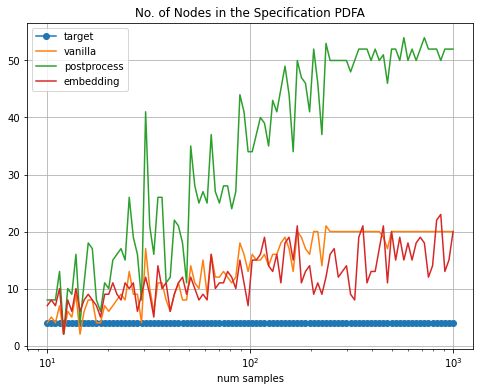

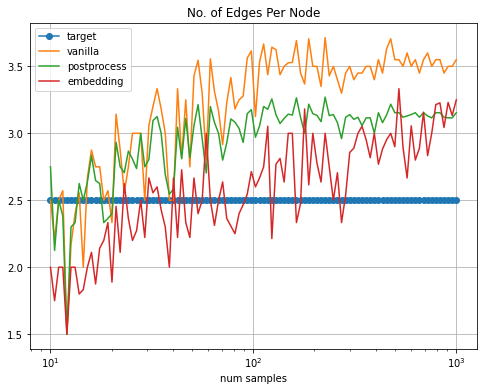

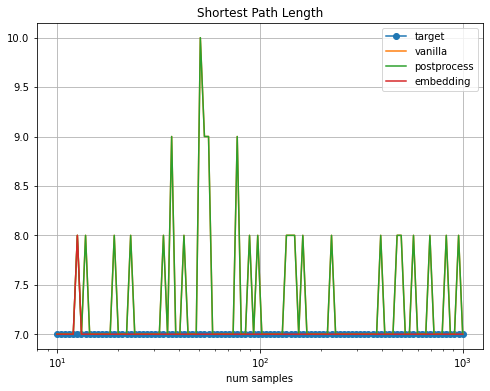

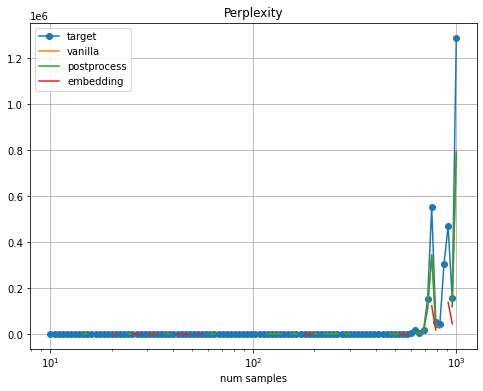

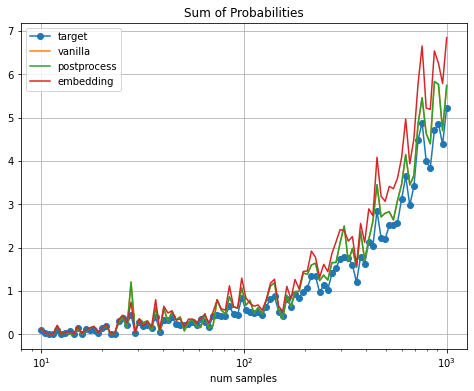

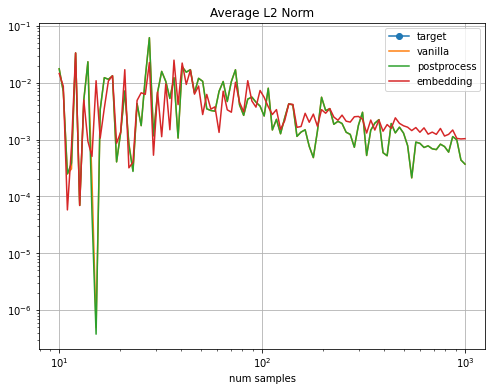

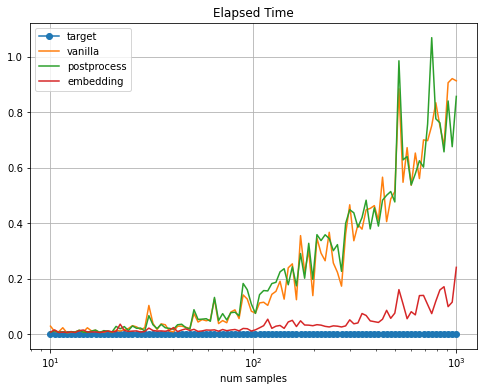

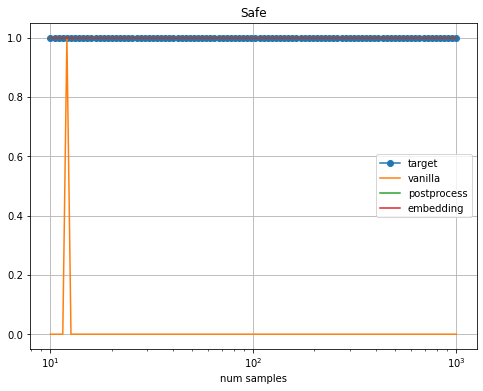

In [47]:
selected_params = {'N': '0', 'p': '0.6'}
plot_selected_results(experiments, params, selected_params)
# selected_params = {'N': '1', 'p': '0.6'}
# plot_selected_results(experiments, params, selected_params)

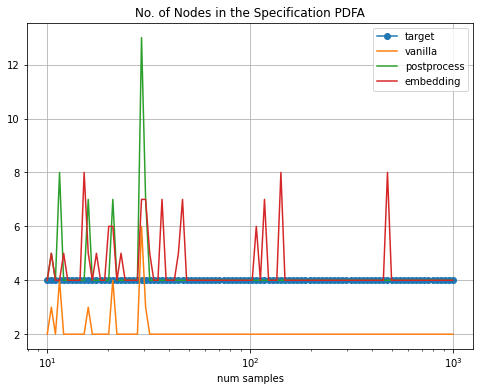

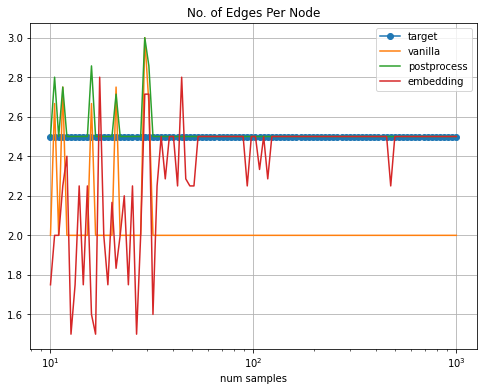

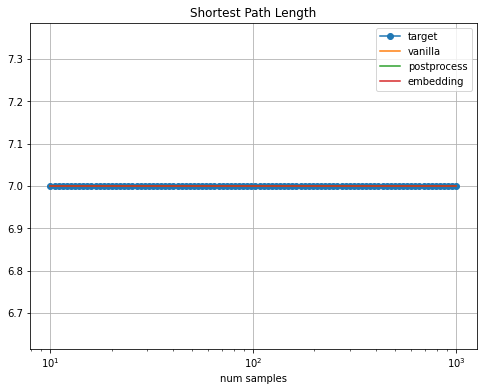

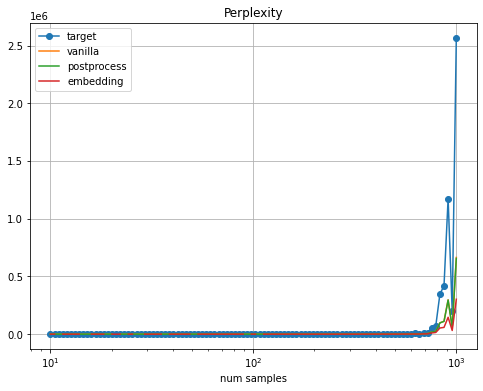

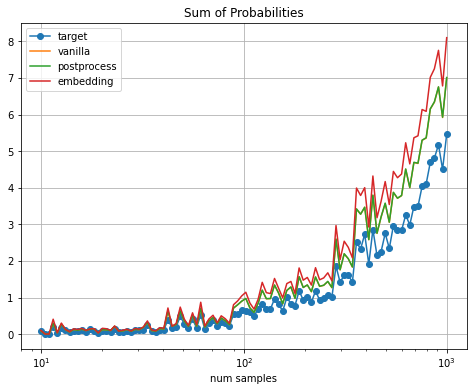

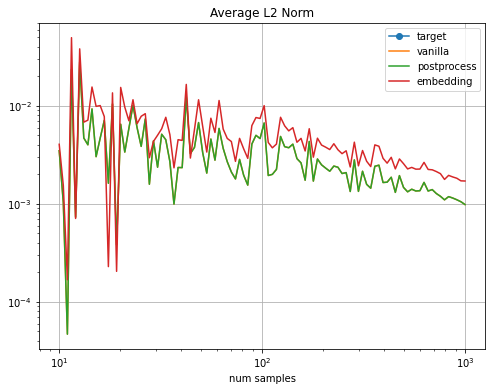

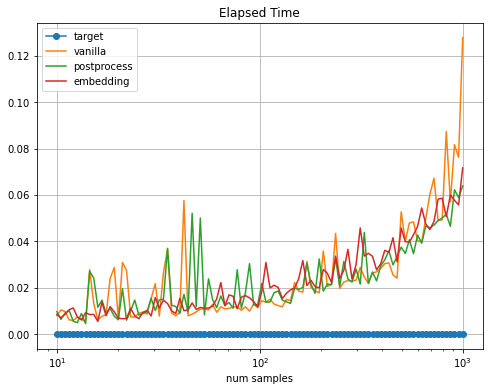

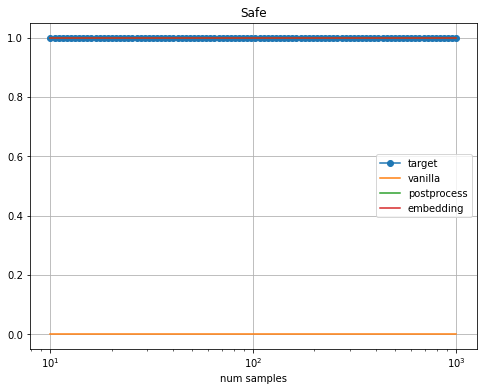

In [48]:
selected_params = {'N': '0', 'p': '1'}
plot_selected_results(experiments, params, selected_params)
# selected_params = {'N': '1', 'p': '1'}
# plot_selected_results(experiments, params, selected_params)

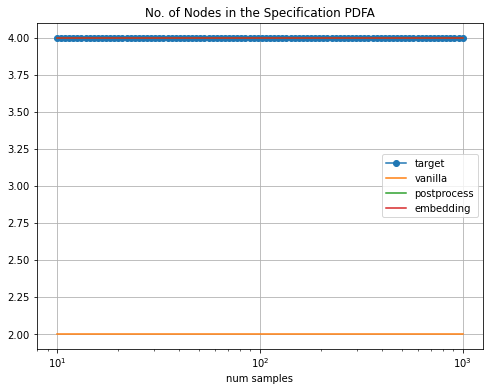

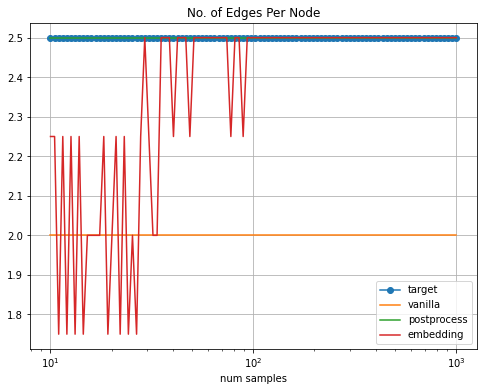

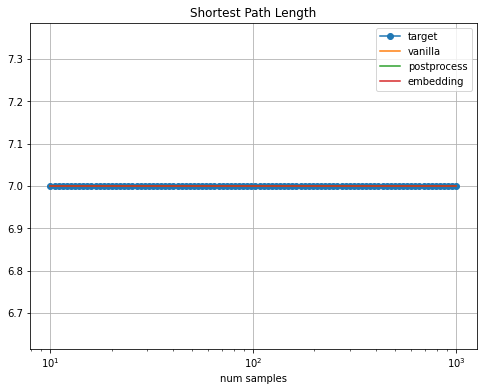

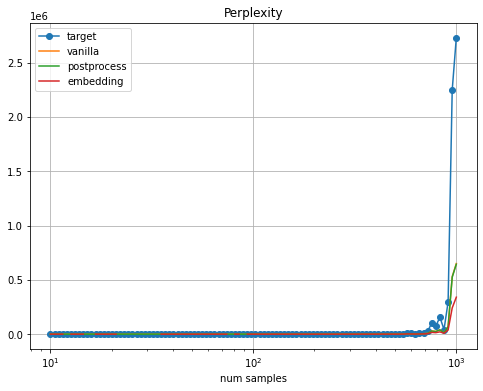

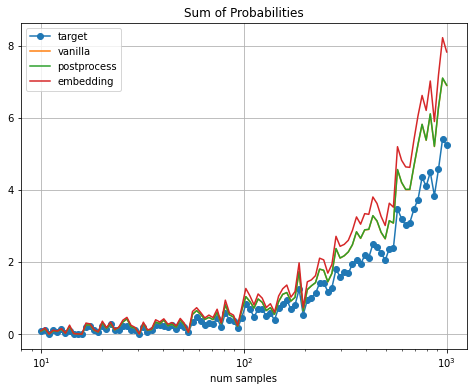

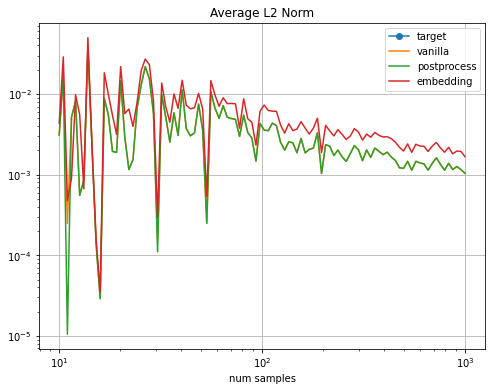

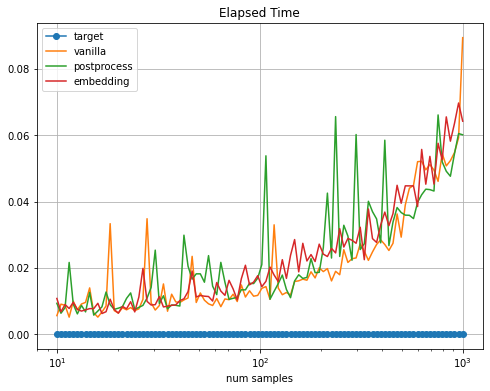

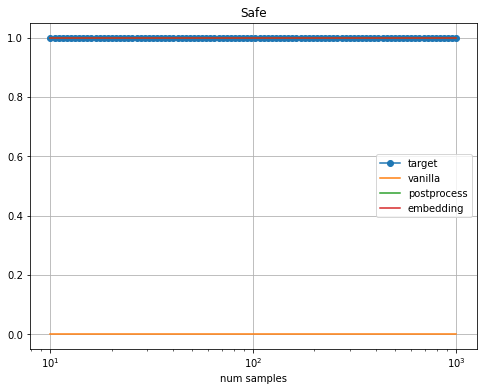

In [49]:
selected_params = {'N': '0', 'p': '2'}
plot_selected_results(experiments, params, selected_params)
# selected_params = {'N': '1', 'p': '2'}
# plot_selected_results(experiments, params, selected_params)

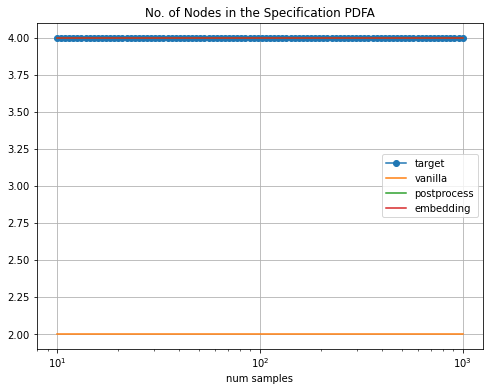

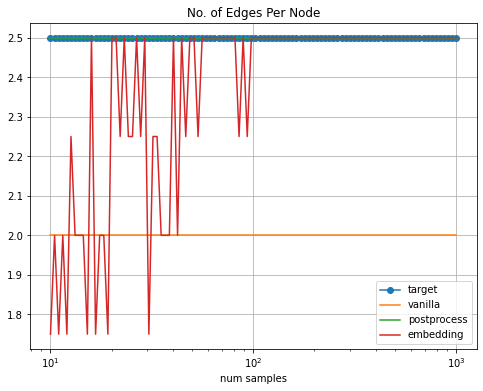

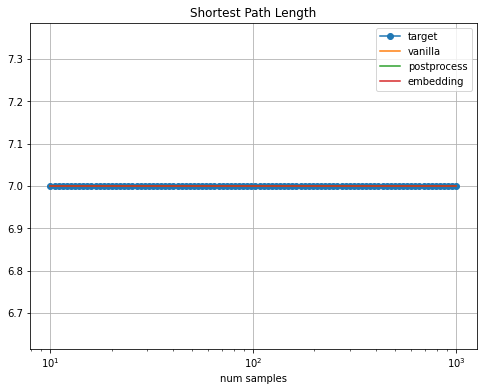

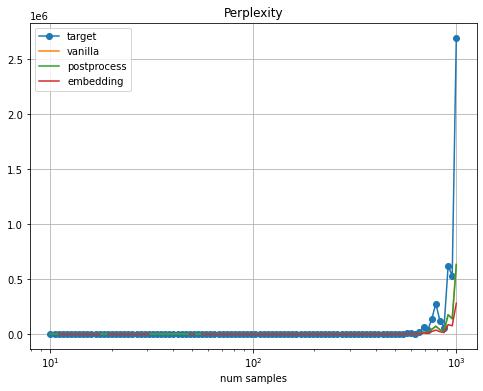

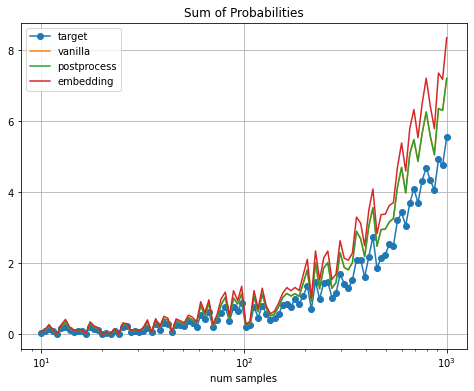

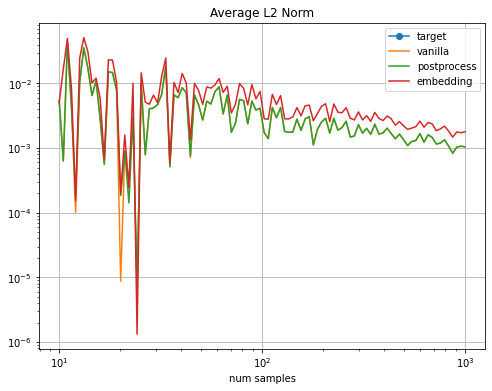

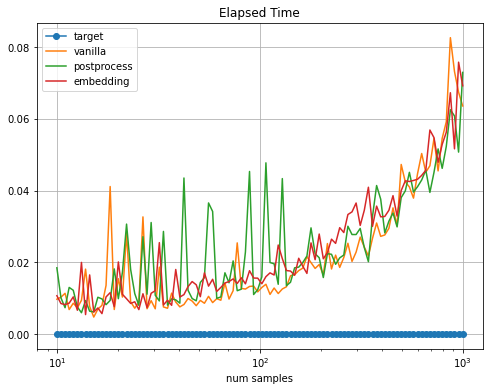

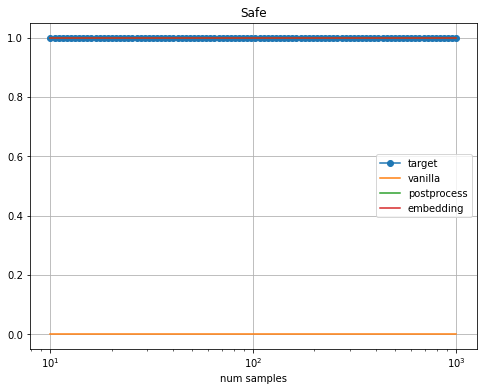

In [50]:
selected_params = {'N': '0', 'p': '5'}
plot_selected_results(experiments, params, selected_params)
# selected_params = {'N': '1', 'p': '5'}
# plot_selected_results(experiments, params, selected_params)

# Experiment with different CoSafe Requirement

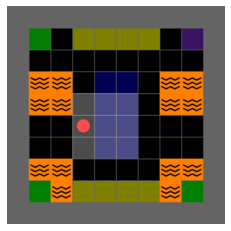

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)


In [51]:
ENV_ID_0 = 'MiniGrid-LavaComparison_SeshiaSecondGoal-v0'

def make_minigrid_TS(env_id):
    env = gym.make(ENV_ID_0)

    env = StaticMinigridTSWrapper(env, actions_type='simple_static',
                                  monitor_log_location=GYM_MONITOR_LOG_DIR)
    env.reset()
    env.render_notebook()

    return active_automata.get(automaton_type='TS', graph_data=env,
                                      graph_data_format='minigrid')

two_goal_minigrid_TS = make_minigrid_TS(ENV_ID_0)

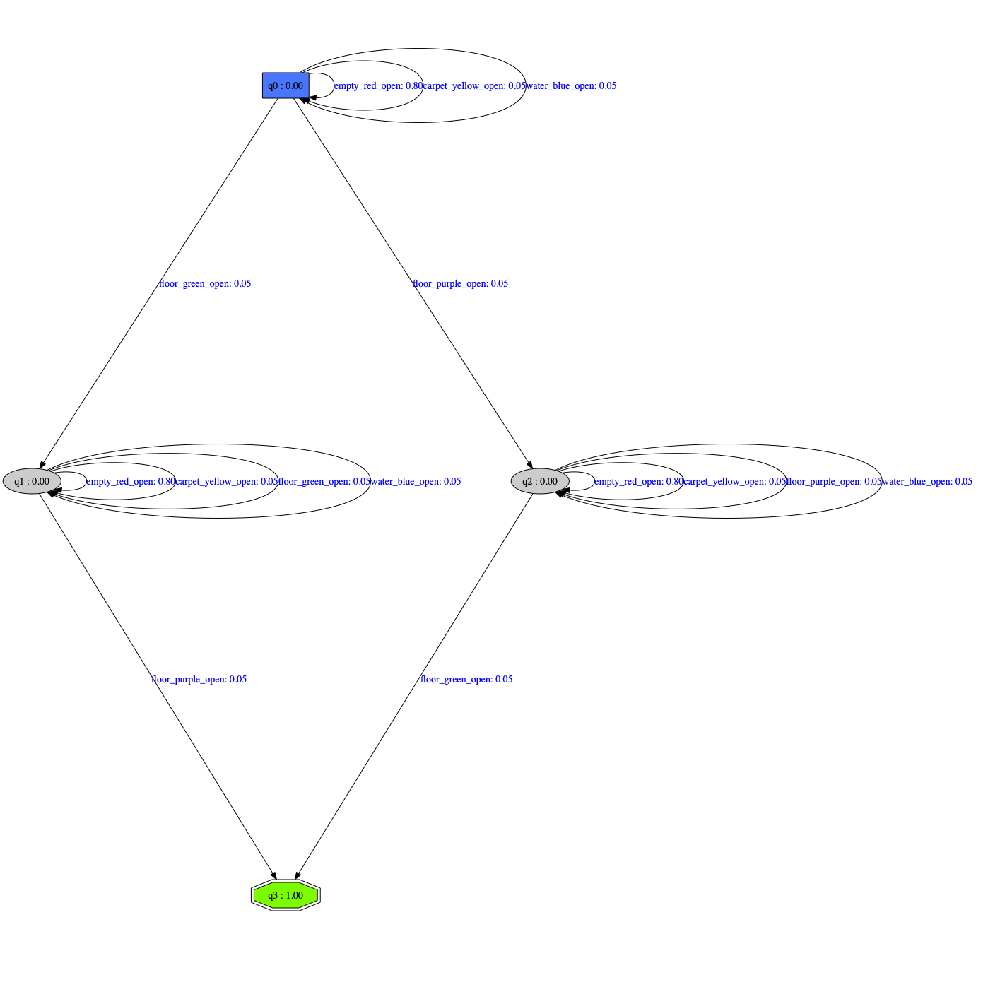

In [52]:
p = Path(PDFA_MODEL_CONFIG_FILE)
PDFA_MODEL_CONFIG_FILE2 = os.path.join(p.parent, p.stem + '_twogoals' + p.suffix)

cosafe_specification2 = active_automata.get(automaton_type='PDFA',
                                           graph_data=PDFA_MODEL_CONFIG_FILE2)

cosafe_specification2.draw('_'.join([EXPERIMENT_NAME, ENV_ID_0, 'PDFA2']))

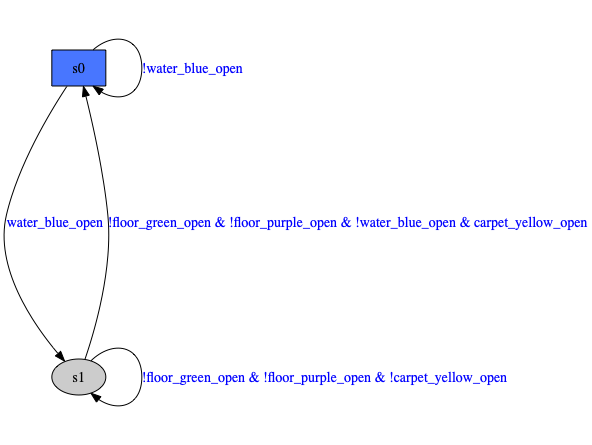

In [53]:
p = Path(DFA_MODEL_CONFIG_FILE)
DFA_MODEL_CONFIG_FILE2 = os.path.join(p.parent, p.stem + '_twogoals' + p.suffix)

safe_specification2 = active_automata.get(automaton_type='DFA',
                                         graph_data=DFA_MODEL_CONFIG_FILE2)
safe_specification2.draw('_'.join([EXPERIMENT_NAME, ENV_ID_0, 'DFA']))

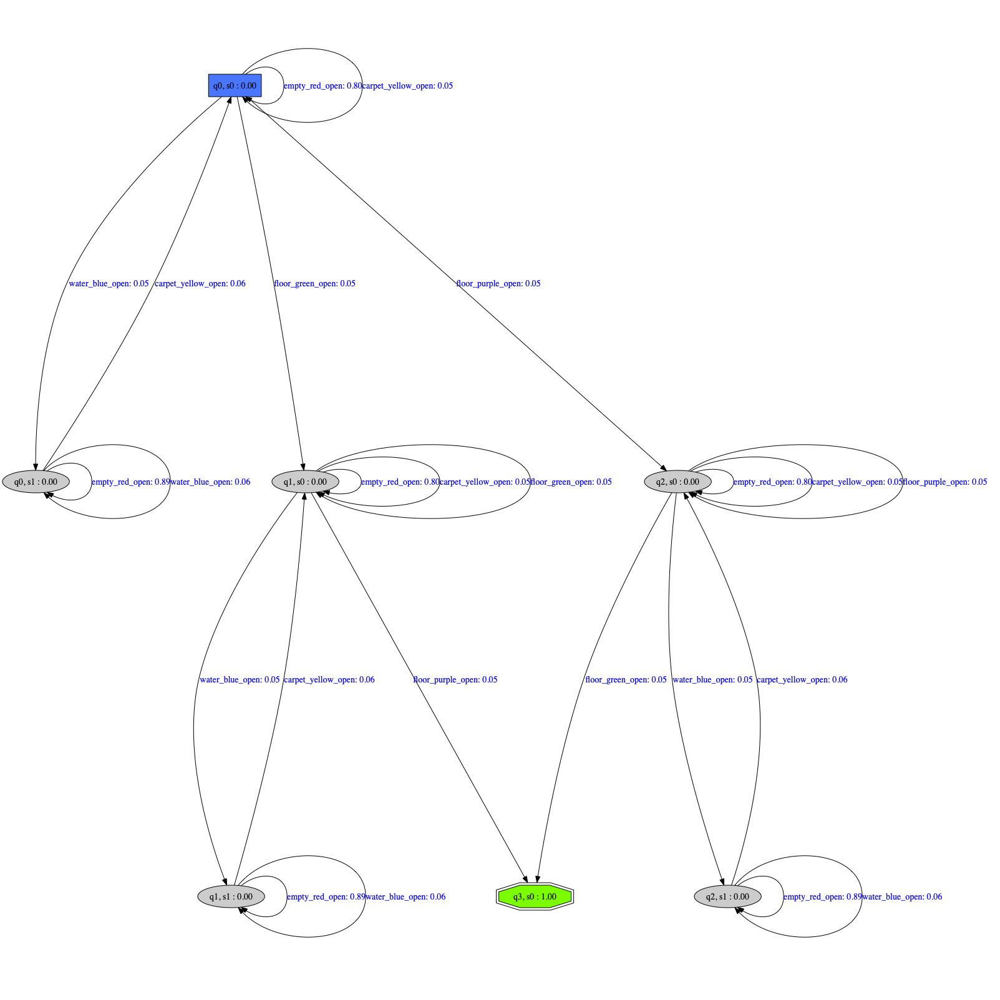

In [54]:
pdfa_specification2 = active_automata.get(automaton_type='PDFA',
                                         graph_data=(cosafe_specification2,
                                                     safe_specification2),
                                         graph_data_format='existing_objects',
                                         normalize_trans_probabilities=True,
                                         delete_sinks=False)
pdfa_specification2.draw('_'.join([EXPERIMENT_NAME, ENV_ID_0, 'PDFA', 'DFA']))

In [56]:
# Parameters that we want to observe
num_samples = np.logspace(1, 2, num=100)
p = ['0.6', '1', '2', '5']
# N = ['0', '1']

# Keys should match with the run_learners argument names
params = {'num_samples': num_samples,
#           'N': N,
          'p': p,
          }

# Products of all the parameters defined above
all_params = itertools.product(*params.values())

# Define an experiment function with default parameters
learners = {'vanilla': VanillaSpecificationLearning(),
            'postprocess': PostprocessingSpecificationLearning(),
            'embedding': EmbeddingSpecificationLearning()}

run_experiment = lambda **kwargs: run_learners(learners=learners, 
                                               safe_specification=safe_specification2, 
                                               minigrid_TS=two_goal_minigrid_TS,
                                               pdfa_specification=pdfa_specification2, 
                                               **kwargs)

# experiments is a dict {(tuple of parameter values), (tuple of pdfas, results)}
experiments2 = {}

# Run each experiment
for each_params in all_params:
    kwargs = dict(zip(params.keys(), each_params))
    print('Running', each_params)
    experiments2[each_params] = run_experiment(**kwargs)

Running (10.0, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99988 x14 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']
Running (10.0, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (10.0, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_erro


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q22) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q22, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']
Running (10.0, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q71) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q49) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q71, s1) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q49, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q20) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (10.235310218990262, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q35) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q35, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q64) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (10.235310218990262, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ov


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q0, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'east', 'west', 'north', 'north', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'water_blue_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']
Running (10.235310218990262, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (10.235310218990262, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ov


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q34) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q34, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q28) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north', 'east', 'south', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (10.476157527896646, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fi


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q60) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q60, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (10.476157527896646, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_de


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q3) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q3, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (10.476157527896646, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
l


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q46) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q46, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (10.476157527896646, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 8 non-zero probability strings when 10 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99979 m99990 m99986 m99978 x12 x12 x12 x12 m99991 x1


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q6) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q6, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'south', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']
Running (10.722672220103231, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistan


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q37) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q37, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']
Running (10.722672220103231, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
l


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q45) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q45, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (10.722672220103231, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ov


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']
Running (10.722672220103231, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']
Running (10.974987654930562, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q68) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q68, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (10.974987654930562, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ov


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q67) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'south', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q67, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'south', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']
Running (10.974987654930562, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
l


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q11) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q11, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']
Running (10.974987654930562, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (11.233240329780276, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q46) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q24) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q46, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q24, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (11.233240329780276, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ov


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q84) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q84, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q33) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (11.233240329780276, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 10 non-zero probability strings when 11 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99965 m99978 m99976 x16 m99998 m99994 m99993 x16 x14


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']
Running (11.233240329780276, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q62) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q83) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q62, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q83, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (11.497569953977356, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 9 non-zero probability strings when 11 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99988 x14 x14 m99990 x14 m99992 m99987 x14 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q45) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q45, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (11.497569953977356, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
e


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q47) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q47) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q47, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q47, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (11.497569953977356, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ov


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q89) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q89, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (11.497569953977356, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ov


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q55) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (11.768119524349984, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (11.768119524349984, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ov


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']
Running (11.768119524349984, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']
Running (11.768119524349984, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q40) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q40, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']
Running (12.045035402587823, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 10 non-zero probability strings when 12 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99954 m99999 m99980 m99959 x16 m99984 x16 m99984 x


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q53) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q30) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q53, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q30, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q43) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q28) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (12.045035402587823, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']
Running (12.045035402587823, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
l


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q42, s1) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q30) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q50) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'south', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']
Running (12.045035402587823, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q5) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q49) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q5, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q49, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'west', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (12.32846739442066, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q31) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q31, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q16) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']
Running (12.32846739442066, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
li


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_purple_open']
Running (12.32846739442066, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_ove


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q30) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q30, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q70) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (12.32846739442066, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q1) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q1) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'west', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q1, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q1, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (12.618568830660204, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q12) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'south', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q12, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'west', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'south', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (12.618568830660204, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_over


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (12.618568830660204, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
ms


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (12.618568830660204, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q56) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q56, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q55) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (12.91549665014884, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (12.91549665014884, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q30) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q30, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (12.91549665014884, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 9 non-zero probability strings when 12 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 m99996 m99988 x14 m99909 x12 m99988 x12 m99936


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q47) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q52) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'east', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q47, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q52, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'east', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'east', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (12.91549665014884, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_dept


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q20) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q42) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q20, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q42, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (13.219411484660288, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 12 non-zero probability strings when 13 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 m99968 x18 m99994 m99984 x18 m99992 x18 x18 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q83) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q83, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q86) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (13.219411484660288, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
ms


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q72) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q57) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q72, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q57, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (13.219411484660288, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
ms


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q51) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'south', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q51, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'south', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'south', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (13.219411484660288, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 11 non-zero probability strings when 13 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99991 x16 m99988 x16 m99973 x16 m99987 m99942


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q51) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q23) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q51, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q23, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (13.530477745798068, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q29) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q28, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q28, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q29, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q23) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'south', 'north', 'north', 'east', 'west', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (13.530477745798068, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_de


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (13.530477745798068, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_de


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q51) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q62, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q51, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q41) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q62) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (13.530477745798068, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ov


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'west', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q61) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q59) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (13.848863713938732, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q18) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q18, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (13.848863713938732, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_over


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q72) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q72, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (13.848863713938732, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q20) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q41) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q46) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q20, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q41, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q46, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q7) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (13.848863713938732, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ov


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q40) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q40, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q7) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q6) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (14.174741629268055, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q2) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q44) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q60) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'south', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q2, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q44, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q60, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'south', 'west', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['west', 'west', 'west', 'east', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (14.174741629268055, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 12 non-zero probability strings when 14 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99979 x18 m99995 m99992 m99968 x18 m99994 m99987 x18


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q66) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q66, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (14.174741629268055, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 13 non-zero probability strings when 14 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 m99982 x20 m99986 x16 m99995 m99991 m99981 x20


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q17) transition distribution
  warnings.warn(str(e))



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q17, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (14.174741629268055, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ov


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q33, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (14.508287784959395, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q23) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q68) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q23, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q68, s0) transition distribution
  warnings.warn(str(e))



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (14.508287784959395, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q50, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q69) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (14.508287784959395, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overla


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q4) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q4, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']
Running (14.508287784959395, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q18) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'south', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q18, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q30, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'south', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'south', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (14.84968262254465, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q52) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q52, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']
Running (14.84968262254465, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
ms


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q54) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q101) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q54, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q101, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q50) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q43) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (14.84968262254465, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_d


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q49) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'west', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q49, s0) transition distribution
  warnings.warn(str(e))



computed controller:  ['north', 'north', 'north', 'east', 'west', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'west', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (14.84968262254465, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
like


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q53, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']
Running (15.199110829529339, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 14 non-zero probability strings when 15 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99974 m99942 x12 m99968 x20 m99999 m99994 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q81) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q81, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q54) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'south', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (15.199110829529339, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q49) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q49, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (15.199110829529339, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q13) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q12) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q13, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q12, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (15.199110829529339, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
l


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q27) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q30, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q27, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q18) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q17) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (15.556761439304722, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q43) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q43, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (15.556761439304722, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ov


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q8) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q58) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q39) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q8, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q58, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q39, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (15.556761439304722, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 13 non-zero probability strings when 15 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99970 m99984 x16 m99995 x16 m99993 x18 m100000 x16 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q56) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q76) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'south', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q56, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q76, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'south', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q63) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (15.556761439304722, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q77) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q77, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (15.922827933410922, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q22) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q67) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q22, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q67, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q66) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (15.922827933410922, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_de


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q10) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q10) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q10, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q18, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q10, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'east', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (15.922827933410922, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_de


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']
Running (15.922827933410922, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'floor_purple_open']
Running (16.297508346206442, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fi


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q23) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q23, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (16.297508346206442, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ov


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q66) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q91) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q66, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q91, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (16.297508346206442, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ov


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q61, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'west', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'south', 'north', 'north', 'west', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (16.297508346206442, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q93) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q93, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (16.68100537200059, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 14 non-zero probability strings when 16 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99991 x22 m99990 x22 m99992 m99986 m99961 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q57) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q0, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q57, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (16.68100537200059, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'floor_purple_open']
Running (16.68100537200059, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_d


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q33) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q35) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q61) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'south', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q33, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q35, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q61, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'south', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q76) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']
Running (16.68100537200059, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
li


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q63) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q63, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q75) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q14) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (17.073526474706906, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q57) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q37) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['south', 'north', 'north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q57, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q37, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'south', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (17.073526474706906, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q102) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q102, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'south', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (17.073526474706906, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 15 non-zero probability strings when 17 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99953 m99992 x16 m99985 m99971 x22 m99835 x18


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q57) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q57, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']
Running (17.073526474706906, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 16 non-zero probability strings when 17 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99990 x24 m99996 m99992 m99978 x24 m99994 m99994 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q99) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q98) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q99, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q98, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q95) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']
Running (17.47528400007684, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4lo


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (17.47528400007684, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ove


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q66, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (17.47528400007684, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
li


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q38) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q54) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q38, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q54, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q3) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q52) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (17.47528400007684, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ove


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q73) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q29) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q73, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q29, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (17.886495290574352, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_dr


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q96) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q96, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (17.886495290574352, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_de


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q44) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q39) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q44, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q39, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (17.886495290574352, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_de


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q16) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q72) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q16, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q72, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q69) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (17.886495290574352, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ov


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q86) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q12) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'west', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q86, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q12, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'west', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'west', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (18.30738280295368, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_ove


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'west', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'west', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'west', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (18.30738280295368, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 16 non-zero probability strings when 18 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99986 x18 m99988 m99987 m99967 m99936 x24 x20 m99996


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q57) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q57, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (18.30738280295368, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 17 non-zero probability strings when 18 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99991 m99987 x26 m99988 x24 m99991 x22 m99993


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (18.30738280295368, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q107) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q71) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q107, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q71, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q70, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (18.73817422860384, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_o


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q17) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q101) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q17, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q101, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q100) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (18.73817422860384, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q36) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q112) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q12) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q36, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q112, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q12, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q125) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (18.73817422860384, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (18.73817422860384, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 15 non-zero probability strings when 18 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99989 m99967 x24 m99990 x22 m99996 x22 m99994 m99992


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q80) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q80, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q53) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (19.179102616724887, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q121) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q121, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q134) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (19.179102616724887, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ov


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q97) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q97, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q93) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q4) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (19.179102616724887, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ov


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q61) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'south', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q61, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'south', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'south', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (19.179102616724887, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q52, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']
Running (19.630406500402703, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 17 non-zero probability strings when 19 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99968 m99967 x26 m99994 m99974 x26 x24 x22 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q41) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q41, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (19.630406500402703, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 16 non-zero probability strings when 19 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 m99987 x24 m99984 m99985 m99986 x24 x22 m99984


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q2) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q2, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (19.630406500402703, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 18 non-zero probability strings when 19 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99995 m99994 m99990 x28 m99992 m99941 x28 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q115) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q115, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (19.630406500402703, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ov


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q24) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q24, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']
Running (20.09233002565047, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 19 non-zero probability strings when 20 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99994 x30 m99948 x26 m99989 x28 m99948 x24 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q93) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q93, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (20.09233002565047, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ove


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q100) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q100, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'south', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q68) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (20.09233002565047, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q69, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q47) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q27) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (20.09233002565047, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q27, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q76, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (20.565123083486515, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q138) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q80) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q80) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q138, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q80, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q80, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['south', 'north', 'north', 'north', 'north', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q68) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (20.565123083486515, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_de


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q123) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q123, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (20.565123083486515, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 18 non-zero probability strings when 20 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99992 m99989 x20 m99996 m99994 x18 m99984 m99975 x24


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q24) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q24, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (20.565123083486515, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ov


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q119, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (21.049041445120206, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
me


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q43) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q9) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q43, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q9, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (21.049041445120206, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 18 non-zero probability strings when 21 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 x22 m99995 m99994 m99992 x26 m99987 x24 m99996


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q52) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q52, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q2) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (21.049041445120206, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 19 non-zero probability strings when 21 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99990 m99989 m99934 m99890 x15 

found intermediate 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q79) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q79) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q79, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q79, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (21.049041445120206, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overla


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q36) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q36) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q39) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q36, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q36, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q39, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (21.544346900318846, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q77) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q77, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (21.544346900318846, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ov


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q114) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q129) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q114, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q129, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q52) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q110) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (21.544346900318846, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overla


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q121) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q121, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']
Running (21.544346900318846, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q83) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q63, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q83, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (22.051307399030456, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q107) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q125) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q18, s1) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q107, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q125, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q19) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q11) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']
Running (22.051307399030456, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 19 non-zero probability strings when 22 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99991 x30 m99996 m99980 x22 m100000 m99995 m99990 m9


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q61) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'west', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q61, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'south', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'south', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (22.051307399030456, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 21 non-zero probability strings when 22 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99986 m99986 x32 m99995 m99994 m99969 x32 x30 m99996


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q135) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'south', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (22.051307399030456, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 20 non-zero probability strings when 22 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99995 m99995 m99978 x32 m99995 m99992 m99951 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q120) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q120, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q1) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (22.570197196339205, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_drive


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q108) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q78) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q78) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q108, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q78, s1) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q78, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'south', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q90) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q89) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (22.570197196339205, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overla


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q41) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q93) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q41, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q93, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (22.570197196339205, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ov


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q48) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q48, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (22.570197196339205, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overla


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q184) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'west', 'west', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q184, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'west', 'west', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q125) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (23.101297000831604, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_dr


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q34) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q92) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q34, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q93, s1) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q92, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q149) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q141) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (23.101297000831604, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
ms


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q122) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q100, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q122, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (23.101297000831604, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ov


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q116) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q117) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q116, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q117, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (23.101297000831604, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 21 non-zero probability strings when 23 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99990 m99967 x28 m99995 m99992 x28 m99992 m99991 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (23.644894126454073, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 20 non-zero probability strings when 23 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99992 m99968 m99967 x32 m99989 x28 m99995 m99991 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q106) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q34) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q34) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q106, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q34, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q34, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (23.644894126454073, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
ms


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q109) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q58) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q109, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q43, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q58, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'south', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'west', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (23.644894126454073, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
lik


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q126) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q21) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q126, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q21, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (23.644894126454073, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 22 non-zero probability strings when 23 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99990 x34 m99997 m99990 m99988 m99972 m99993 x34 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q13) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q13, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q88) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (24.20128264794382, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 23 non-zero probability strings when 24 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99991 x34 m99996 m99994 m99992 m99967 x36 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q95) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q95, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q137) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (24.20128264794382, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ove


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q109) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q109, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (24.20128264794382, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q62) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q115) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q147) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q62, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q115, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q147, s1) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q80) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q63) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (24.20128264794382, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 22 non-zero probability strings when 24 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99992 m99973 x34 m99997 m99991 m99978 m99915 x34 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q20) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q78) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q78) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q20, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q78, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q78, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q130) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (24.770763559917114, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'east', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q158) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q157) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (24.770763559917114, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_de


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q126) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q94) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q46) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q126) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q126, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q94, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q46, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q126, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q127) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (24.770763559917114, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
ms


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q104) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q139) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q35) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q104, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q139, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q35, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q61) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (24.770763559917114, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ov


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q154) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q154, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q32) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_purple_open']
Running (25.353644939701113, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 23 non-zero probability strings when 25 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99994 m99988 x36 m99995 x34 m99997 m99941 x


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q11) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q92) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q11, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q92, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (25.353644939701113, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ov


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q161) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q37) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q161, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q37, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (25.353644939701113, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 24 non-zero probability strings when 25 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99992 m99974 x36 m99994 m99985 m99958 x36 m99995 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q161) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q100, s1) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q161, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q4) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (25.353644939701113, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 22 non-zero probability strings when 25 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99991 m99987 m99969 x32 m99972 m99792 x28 m99992 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q105) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q14) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q105, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q14, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q14, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q94) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (25.95024211399736, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q167) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']
Running (25.95024211399736, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
ms


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q105) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q25) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q105, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q75, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q25, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q112) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (25.95024211399736, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ove


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q71) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q71, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q4, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (25.95024211399736, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q107) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q107) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q107, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q107, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q4, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (26.560877829466868, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 23 non-zero probability strings when 26 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99988 m99961 m99995 x34 m99993 m99993 m99991 x34 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q82) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q90) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q82, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q90, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q64) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (26.560877829466868, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overla


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['west', 'west', 'east', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['west', 'south', 'north', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q115) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q75) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (26.560877829466868, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 24 non-zero probability strings when 26 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99996 x34 m99993 m99988 m99968 x26 m99993 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q113) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q113, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (26.560877829466868, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ov


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'south', 'north', 'north', 'west', 'north', 'north', 'south', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q144) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q59) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (27.1858824273294, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q129) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q129, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q152) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (27.1858824273294, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 26 non-zero probability strings when 27 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99986 m99958 m99993 x32 m99996 m99995 x28 m99999 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q136) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'east', 'north', 'east', 'east', 'east', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'water_blue_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q136, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'floor_purple_open']
Running (27.1858824273294, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_de


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q91) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q90) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q91, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q90, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (27.1858824273294, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
over


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q130) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q130, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q47, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q125, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (27.825594022071243, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_ov


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q196) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q196, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (27.825594022071243, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 23 non-zero probability strings when 27 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99992 m99980 x36 m99998 m99978 x36 m99992 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q37) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q113) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q40) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q37, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q113, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q40, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q133) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q22) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q99) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q133) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (27.825594022071243, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ov


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q116) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q9) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'west', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q163, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q116, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q9, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'west', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (27.825594022071243, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
al


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q88) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q112) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'north', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q88, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q112, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'north', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'north', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (28.48035868435802, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 26 non-zero probability strings when 28 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 x40 m99992 m99986 x36 m99994 m99992 m99991 x


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q123) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q123, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q84) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (28.48035868435802, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
like


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q103) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q103, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q56) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q58) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (28.48035868435802, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_d


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q135) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q154) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q71) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q1, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q135, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q154, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q71, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q140) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (28.48035868435802, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ove


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q136) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q136) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q136, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q136, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q129) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q26) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q97) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q155) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (29.150530628251772, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 26 non-zero probability strings when 29 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 x36 m99996 m99987 m99981 x32 m99997 m99994 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q21) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q58, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q21, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (29.150530628251772, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 25 non-zero probability strings when 29 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99989 x36 m99996 m99992 m99970 x32 m99985 x24


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q3) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (29.150530628251772, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ov


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (29.150530628251772, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 28 non-zero probability strings when 29 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 m99991 m99987 x38 m99996 m99978 x38 m99995 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q156) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q145) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q190) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q145) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q156, s1) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q143, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q145, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q190, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton

computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q139) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (29.836472402833405, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (29.836472402833405, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
ms


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q84) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'south', 'north', 'west', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q84, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q38, s1) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'west', 'west', 'east', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (29.836472402833405, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
ms


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q127) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q127, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (29.836472402833405, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q147, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q64, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q6) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q103) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q103) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q121) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['south', 'north', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (30.538555088334157, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q48) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q106) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q106) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q91) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q48, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q106, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q106, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q91, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q187) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (30.538555088334157, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 28 non-zero probability strings when 30 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 m99993 m99969 m99937 x44 m99999 m99994 x42 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q59) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']
Running (30.538555088334157, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
l


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q92) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q159) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q92, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q159, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']
Running (30.538555088334157, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 29 non-zero probability strings when 30 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99991 x40 m99938 x38 m99990 m99987 x30 m99995


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q155) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q71, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q155, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q155, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q117) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (31.25715849688237, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 30 non-zero probability strings when 31 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99983 x38 m99989 x38 m99996 m99987 x34 m999


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q113) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q132) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (31.25715849688237, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 29 non-zero probability strings when 31 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99988 x40 m99994 m99989 m99974 x30 m99990 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']
Running (31.25715849688237, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
li


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q59, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (31.25715849688237, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q178) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q150) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q178, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q150, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q168) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (31.992671377973846, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q128) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q117) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q40) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q128, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q117, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q40, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q125) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'south', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (31.992671377973846, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
l


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'south', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'south', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'south', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (31.992671377973846, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q118) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q69) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q82) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q123) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q118, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q69, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q82, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q123, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (31.992671377973846, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q133) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'east', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q133, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'east', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q144) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (32.74549162877728, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q26) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'south', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q26, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q125, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'south', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (32.74549162877728, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 31 non-zero probability strings when 32 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99998 m99987 x44 m99990 x44 m99997 m99996 m99996 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'south', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q117, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'south', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (32.74549162877728, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
ev


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q10) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q10, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (32.74549162877728, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q81) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q19) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q19, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q81, s1) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q81, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q19, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q64) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (33.516026509388425, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 29 non-zero probability strings when 33 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99992 m99991 x40 m99995 m99993 x40 m99994 m99992 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (33.516026509388425, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 32 non-zero probability strings when 33 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99995 x46 m99995 m99996 m99996 x46 m99996 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q102) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q102) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q102, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q102, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q64, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (33.516026509388425, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_de


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q95) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q95) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q142) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q95, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q95, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q142, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q153) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (33.516026509388425, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
ms


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q160) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q170) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q160, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q170, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q29) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q168) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (34.30469286314919, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 33 non-zero probability strings when 34 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99975 m99990 x28 m99991 m99987 m99947 x28 m99999 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_purple_open']
Running (34.30469286314919, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 32 non-zero probability strings when 34 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99990 m99980 x42 m99993 m99993 m99978 m99945 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q159) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q159, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (34.30469286314919, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 31 non-zero probability strings when 34 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99992 m99959 m99991 x30 m99997 m99978 m99951 x20 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'south', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'south', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (34.30469286314919, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
ale


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q21) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q138) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q128) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q21, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q138, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q128, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'south', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q191) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (35.11191734215131, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_over


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q77) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q77, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (35.11191734215131, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_d


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q97) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q97, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (35.11191734215131, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
like


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q131) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q153) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q153) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q131, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q153, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q153, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (35.11191734215131, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q167) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q62) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (35.938136638046274, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 32 non-zero probability strings when 35 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99954 m99996 x28 m99959 m99995 m99984 x28 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q64) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q64, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']
Running (35.938136638046274, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q146) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'west', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q146, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'west', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q18) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'south', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (35.938136638046274, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overl


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q219) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q104) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'west', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q219, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q104, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'west', 'west', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q148) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (35.938136638046274, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
ms


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q118) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q118, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q21) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (36.783797718286344, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 29 non-zero probability strings when 36 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99966 m99992 x26 m99978 x20 m99998 m99996 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q134) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q68, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q134, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q134, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']
Running (36.783797718286344, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
l


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q13) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'east', 'north', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'water_blue_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q13, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q132) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (36.783797718286344, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 35 non-zero probability strings when 36 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99989 m99966 x34 m99995 m99983 m99931 x22 m99994 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (36.783797718286344, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 34 non-zero probability strings when 36 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99995 m99995 x54 m99995 m99951 x46 m99993 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q70) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q32, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q70, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (37.64935806792467, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q77) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q133) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q142) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q142) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q77, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q133, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q142, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q142, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (37.64935806792467, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 35 non-zero probability strings when 37 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99993 m99928 x56 m99994 m99994 x50 m99989 x44


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q170) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q111) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q188) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q170) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q170, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q111, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q188, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q170, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q173) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q173) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (37.64935806792467, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
ove


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q114) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (37.64935806792467, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 34 non-zero probability strings when 37 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99958 m99990 x34 m99997 x32 m99993 x28 m99992


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q95) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q181) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q95, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q86, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q181, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (38.53528593710529, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 36 non-zero probability strings when 38 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99994 m99993 m99985 x56 m99997 m99996 x52 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q133) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q97) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q133, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q121, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q97, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q103) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (38.53528593710529, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 33 non-zero probability strings when 38 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99992 m99991 m99969 x42 m99997 m99996 m99991 m99989 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q21) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q123) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q21, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q123, s1) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q120) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (38.53528593710529, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (38.53528593710529, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 37 non-zero probability strings when 38 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99991 m99988 m99986 x46 m99992 m99992 m99993 x46 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q169) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q137) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q69) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'south', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q78, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q169, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q137, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q69, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (39.442060594376564, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 35 non-zero probability strings when 39 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99994 x56 m99998 m99995 x52 m99997 m99996 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q111) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q211) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'south', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q111, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q211, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'west', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (39.442060594376564, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 37 non-zero probability strings when 39 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99989 m99958 m99984 x30 m99989 m99940 m99995 m99904 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'north', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'north', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q122) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (39.442060594376564, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
al


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q189) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q120) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q168) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q120) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q189, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q120, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q168, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q120, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'east', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (39.442060594376564, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 38 non-zero probability strings when 39 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99977 x54 m99998 m99987 x44 m99997 m99996 x44


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q163) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q118) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q231) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'south', 'north', 'west', 'west', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q163, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q118, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q231, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q207) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q11) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (40.37017258596554, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_o


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q164) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q164, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (40.37017258596554, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 39 non-zero probability strings when 40 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99986 x44 m99999 m99993 m99992 x42 m99996 x42 m99993


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q110) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q110) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q110, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q110, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q127, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (40.37017258596554, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 38 non-zero probability strings when 40 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 m99989 x42 m99994 x30 m99998 m99997 m99984 x30


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q175) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q119) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'west', 'west', 'east', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q175, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q119, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'west', 'west', 'east', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q146) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (40.37017258596554, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 37 non-zero probability strings when 40 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99994 x58 m99995 x54 m99991 m99981 m99983 x44


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q5) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q5) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q5) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q5, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q5, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q5, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'west', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'south', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (41.32012400115339, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 37 non-zero probability strings when 41 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99989 x48 m99997 m99988 m99987 x38 m99994 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q75) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'west', 'west', 'west', 'east', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q75, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q168, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'west', 'west', 'west', 'east', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'south', 'north', 'west', 'north', 'north', 'north', 'south', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (41.32012400115339, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 39 non-zero probability strings when 41 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 m99954 m99995 x38 m99999 m99957 x24 m99999 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q202) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['east', 'west', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'water_blue_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q202, s1) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q191) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (41.32012400115339, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overl


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q7) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'north', 'south', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q7, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q6, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q50, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'north', 'south', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q183) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q190) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q140) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']
Running (41.32012400115339, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 38 non-zero probability strings when 41 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 x60 m99997 m99978 x60 m99997 m99994 m99989 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q202) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q176) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q47) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q182) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q202, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q176, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q47, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q182, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'south', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q79) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (42.29242874389499, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 40 non-zero probability strings when 42 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99989 m99986 x54 m99994 m99990 x52 m99995 m99995 x


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q222) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q222) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'west', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q222, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q222, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'west', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q144) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (42.29242874389499, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 39 non-zero probability strings when 42 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 m99993 x56 m99993 m99978 m99968 x46 m99996 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q194) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q194) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q194, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q3, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q194, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q6) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (42.29242874389499, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 41 non-zero probability strings when 42 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99994 m99994 x64 m99998 m99992 m99976 x52 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q145) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q37) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q145, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q37, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (42.29242874389499, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q189) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q18) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q204, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q189, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q18, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q159) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q159) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (43.287612810830595, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 42 non-zero probability strings when 43 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99993 m99949 x42 m100000 m99999 x32 m99984 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q193) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q181) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q194) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (43.287612810830595, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 38 non-zero probability strings when 43 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99997 x60 m99992 m99958 m99996 x34 m99998 x28


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q88, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q163) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'south', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'empty_red_open', 'floor_purple_open']
Running (43.287612810830595, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 40 non-zero probability strings when 43 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99971 x56 m99995 m99992 m99982 x46 m99995 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q214) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q214, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q236) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q140) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (43.287612810830595, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_de


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q91) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q91, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q120, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['east', 'west', 'north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'west', 'east', 'east']
runs:  ['empty_red_open', 'water_blue_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q84) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (44.30621457583882, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 41 non-zero probability strings when 44 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99987 m99981 m99945 x36 m99995 x32 m99986 m99953 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q150) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'east', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q150, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'east', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q189) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']
Running (44.30621457583882, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 43 non-zero probability strings when 44 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 m99995 m99993 x64 m99996 m99994 x58 m99995 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q211) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'south', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q211, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (44.30621457583882, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
cou


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q109) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q10) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q267) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['south', 'south', 'north', 'north', 'north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q109, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q10, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q267, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'west', 'west', 'east', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q166) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q240) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q166) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (44.30621457583882, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 42 non-zero probability strings when 44 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99998 m99982 m99943 x38 m99987 m99989 m99964 x60 m10


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q239) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q239, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q218) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q115) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']
Running (45.34878508128582, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 38 non-zero probability strings when 45 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99971 m99975 x42 m99998 x34 m99994 m99984 x32 m999


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q156) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q150) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'south', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q156, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q150, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (45.34878508128582, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 42 non-zero probability strings when 45 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99991 x60 m99997 m99991 m99990 x48 m99995 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q19) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q235) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q19, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q235, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q142) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (45.34878508128582, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 43 non-zero probability strings when 45 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99992 m99949 x42 m100000 m99995 m99921 m99984


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q193) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q193, s1) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q148) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (45.34878508128582, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
ale


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q73) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q192) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q73, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q192, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'south', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q223) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (46.4158883361278, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixe


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q59) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q59, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q59, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (46.4158883361278, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overla


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q192) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q42) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q121) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q26) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: 

computing strategy ...



computed controller:  ['north', 'north', 'north', 'south', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q192, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q42, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q121, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q26, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automat

computing strategy ...



computed controller:  ['north', 'north', 'north', 'south', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q238) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q204) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (46.4158883361278, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 44 non-zero probability strings when 46 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99995 m99987 x56 m99998 m99997 m99994 m99987 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q104) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q104, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q226) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q36) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['south', 'north', 'north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (46.4158883361278, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_de


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q91) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q162) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'south', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q91, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q162, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q215) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (47.50810162102798, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q105) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q48) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q224) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q152) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: 

computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'north', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q105, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q48, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q224, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q152, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automat

computing strategy ...



computed controller:  ['south', 'south', 'east', 'east', 'east', 'north', 'north', 'north', 'north', 'north', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q72) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q80) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q242) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'west', 'east', 'east', 'east', 'north', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (47.50810162102798, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 42 non-zero probability strings when 47 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99991 m99991 x62 m99997 m99993 x52 m99993 m99984 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q87) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q87, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q219) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (47.50810162102798, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 43 non-zero probability strings when 47 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99998 m99995 x60 m99996 m99996 m99992 x60 m99997 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q169) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q272) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q51) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q169, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q272, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q51, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q272) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q173) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['south', 'north', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (47.50810162102798, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 46 non-zero probability strings when 47 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99991 m99950 x38 m99993 m99984 m99924 m99937 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (48.62601580065353, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 42 non-zero probability strings when 48 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 m99995 x64 m99998 m99986 x52 m99996 m99992 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q210) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q210, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q130) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (48.62601580065353, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 47 non-zero probability strings when 48 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99972 x68 m99996 m99993 m99992 m99991 x68 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q210) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q259) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q260) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q210, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q259, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q260, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q240) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'south', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (48.62601580065353, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 44 non-zero probability strings when 48 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99996 x62 m99989 m99989 x54 m99989 m99991 x40


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q32) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'west', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q166, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q32, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q23, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q124) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (48.62601580065353, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 45 non-zero probability strings when 48 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99993 m99984 x56 m99995 x44 m99996 m99957 x38


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q74) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q156, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q116, s1) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q74, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q182) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q175) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (49.770235643321115, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 47 non-zero probability strings when 49 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 m99994 m99992 x56 m99990 m99991 m99985 x52 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q221) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q124) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q221, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q124, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q292) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q141) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'east', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (49.770235643321115, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 45 non-zero probability strings when 49 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99993 m99993 x70 m99989 m99969 x64 m99994 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q175) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'east', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q114, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q175, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'south', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (49.770235643321115, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 48 non-zero probability strings when 49 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99988 x60 m99997 m99994 m99989 x56 m99995 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q26, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (49.770235643321115, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_de


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q73) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q73, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q234) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q234) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (50.9413801481638, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 47 non-zero probability strings when 50 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99991 m99985 x66 m99995 m99993 m99975 x54 m99996 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q182) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q42) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q182, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q42, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q134, s1) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q199) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (50.9413801481638, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q10) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q10, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q226) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q244) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (50.9413801481638, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 49 non-zero probability strings when 50 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99995 x70 m99994 m99993 m99993 x60 m99996 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q24) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q142) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q55) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q24, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q240, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q142, s1) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q55, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'south', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q74) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q285) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q186) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q305) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (50.9413801481638, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 46 non-zero probability strings when 50 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99996 m99989 x68 m99996 m99996 m99989 x66 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q55) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q228) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q55, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q228, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'east', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['west', 'west', 'west', 'east', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (52.14008287999685, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 49 non-zero probability strings when 52 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99992 m99992 m99992 x58 m99998 m99995 m99993 m9999


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (52.14008287999685, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 51 non-zero probability strings when 52 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99986 x66 m99994 m99994 m99989 x58 m99992 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q176) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q11, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q176, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q144, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (52.14008287999685, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_d


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q293) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q60) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q117) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q293) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q293, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q60, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q117, s1) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q293, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q307) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q307) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q307) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (52.14008287999685, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 50 non-zero probability strings when 52 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99991 m99980 x68 m99993 m99993 m99987 x60 m10


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q102) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q109) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q102, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q109, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q54) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q280) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (53.3669923120631, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 52 non-zero probability strings when 53 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99972 m99990 m99948 x44 m99980 x40 m99997 m99995 x


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q66) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q254) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q166) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['east', 'west', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'water_blue_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q66, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q254, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q166, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q170) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'west', 'north', 'north', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (53.3669923120631, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 50 non-zero probability strings when 53 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99973 m99927 x44 m99995 m99988 x40 m99996 m99995 x38


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q131) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'west', 'north', 'north', 'north', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (53.3669923120631, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 51 non-zero probability strings when 53 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99998 m99995 m99991 x70 m99996 m99988 m99919 x68 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q65) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q267) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'south', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q65, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q267, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q263) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q149) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'east', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (53.3669923120631, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 49 non-zero probability strings when 53 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99984 x68 m99991 m99990 x58 m99994 m99991 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q28) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q273) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q139) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q28, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q273, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q139, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (54.62277217684343, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 53 non-zero probability strings when 54 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99993 m99991 x66 m99996 m99996 m99995 m9999


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q253) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q286) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['south', 'north', 'north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q253, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q286, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q281) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['south', 'north', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (54.62277217684343, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 52 non-zero probability strings when 54 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99970 m99944 x48 m100000 m99993 m99946 m99994 x36 m1


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (54.62277217684343, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 48 non-zero probability strings when 54 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99989 m99952 x42 m99992 m99986 m99941 m99852 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (54.62277217684343, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
ale


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q229) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q21, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q229, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'west', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (55.90810182512222, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 50 non-zero probability strings when 55 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99984 x68 m99998 m99997 m99996 m99979 x68 m99995 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q225) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q182) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q225) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q225, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q182, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q225, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'south', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q168) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (55.90810182512222, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
cou


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'floor_purple_open']
Running (55.90810182512222, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 51 non-zero probability strings when 55 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99985 x68 m99996 m99995 x60 m99994 m99990 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q180) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q38, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q180, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (55.90810182512222, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 53 non-zero probability strings when 55 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 m99986 x70 m99996 x48 m99996 m99994 x44 m99996


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q211) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q121, s1) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q211, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q210) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q97) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q104) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'south', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (57.2236765935022, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 56 non-zero probability strings when 57 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99988 x80 m99989 m99986 m99985 x56 m99991 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q203) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q234) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q149) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'north', 'south', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q64, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q203, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q234, s1) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q203, s1) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automat

computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'north', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'north', 'east', 'north', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (57.2236765935022, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 55 non-zero probability strings when 57 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99996 m99988 x88 m99995 m99995 x82 m99997 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q278) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q278, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q221) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (57.2236765935022, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
lik


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q188) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q188, s1) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'south', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'empty_red_open', 'floor_purple_open']
Running (57.2236765935022, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 52 non-zero probability strings when 57 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99992 m99990 x68 m99993 m99991 m99976 x68 m99997 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q132) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q132, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q132, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q294) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (58.570208180566674, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 52 non-zero probability strings when 58 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99995 m99944 x52 m99997 m99991 m99944 m9998


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (58.570208180566674, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 54 non-zero probability strings when 58 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99985 x74 m99997 m99996 x64 m99997 m99993 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q164) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q163) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q164, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q29, s1) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q163, s1) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'east', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q265) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (58.570208180566674, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 55 non-zero probability strings when 58 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99994 x76 m99997 m99995 m99994 x68 m99994 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q59) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q245) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'east', 'south', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q59, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q245, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'east', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']
Running (58.570208180566674, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (59.94842503189409, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 57 non-zero probability strings when 59 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99994 m99982 x74 m99996 m99982 x64 m99996 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q135, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q132, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q286) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (59.94842503189409, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 55 non-zero probability strings when 59 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99992 m99989 x68 m99996 m99995 x52 m99997 x42


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'east', 'west', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'water_blue_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q247) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'east', 'west', 'north', 'north', 'south', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'water_blue_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (59.94842503189409, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixe


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q295) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q295, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (59.94842503189409, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 54 non-zero probability strings when 59 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99996 m99993 m99969 x86 m99995 m99936 x72 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q180) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q315) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q180, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q315, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q246) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (61.35907273413176, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 59 non-zero probability strings when 61 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99996 m99995 x78 m99998 m99995 m99987 x70 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['west', 'east', 'south', 'south', 'north', 'north', 'north', 'north', 'north', 'west', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'south', 'south', 'north', 'north', 'west', 'north', 'north', 'south', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q25) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q228) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (61.35907273413176, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q87) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q87) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q184) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q87) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'east', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q124, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q87, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q87, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q184, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdf

computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'east', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (61.35907273413176, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_dep


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q70) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q322) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q70, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q322, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q356) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q244) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (61.35907273413176, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 60 non-zero probability strings when 61 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99999 m99995 m99994 x90 m99996 m99995 m99995 x78 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q336) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q148) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'west', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q62, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q336, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q148, s1) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'south', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['south', 'north', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (62.80291441834253, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 60 non-zero probability strings when 62 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 m99987 x74 m99995 m99993 m99990 x62 m99995 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q305) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q206) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q139) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q305, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q206, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q139, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['south', 'north', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (62.80291441834253, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 58 non-zero probability strings when 62 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99988 x74 m99996 m99995 m99992 m99987 x60 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q251) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q260) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q143) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q100) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: Use

computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q251, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q260, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q143, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q159, s1) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/p

computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q217) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q217) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q273) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q217) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (62.80291441834253, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q138) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q138, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']
Running (62.80291441834253, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 57 non-zero probability strings when 62 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 x80 m99996 m99994 m99944 x72 m99994 m99993 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q171) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q108) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q172) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q193) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q171, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q193, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q108, s1) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q172, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automat

computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'west', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q33) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q284) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']
Running (64.28073117284322, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 60 non-zero probability strings when 64 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99991 m99985 x82 m99996 m99987 m99985 x70 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q276) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'west', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q276, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q163, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q13, s1) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'west', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q202) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q245) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'south', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (64.28073117284322, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 62 non-zero probability strings when 64 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99992 m99960 x56 m99998 m99993 x44 m99996 m99948 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q232) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (64.28073117284322, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 61 non-zero probability strings when 64 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99987 x80 m99995 m99994 x70 m99993 m99988 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q4) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q272) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q251) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q326) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q4, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q272, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q251, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q326, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q271) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (64.28073117284322, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overl


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q112) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['east', 'west', 'north', 'north', 'north', 'north', 'west', 'west']
runs:  ['empty_red_open', 'water_blue_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']
Running (65.79332246575683, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 63 non-zero probability strings when 65 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99988 x78 m99996 m99994 m99988 m99988 x68 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q114) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q114, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (65.79332246575683, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 60 non-zero probability strings when 65 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99998 m99991 x68 m99996 m99993 m99955 m99992 x68 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q283) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q288) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q283, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q288, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (65.79332246575683, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 62 non-zero probability strings when 65 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99998 m99997 m99996 x94 m99998 m99998 m99989 m99987 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q324) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q324) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q324) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q312) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q324, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q324, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q324, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q312, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'south', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q325) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q325) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q89) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q325) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (65.79332246575683, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
cou


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q218) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q280) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q218, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q280, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q257) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q86) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']
Running (67.34150657750821, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_o


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q346) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q15) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q346, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q15, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q283) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q282) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q303) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q346) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208:

computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'south', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (67.34150657750821, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 63 non-zero probability strings when 67 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99998 m99994 m99990 x78 m99997 m99994 m99994 m99991 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q265) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'east', 'west', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'water_blue_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q271, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q265, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q69, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q58) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q280) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'west', 'north', 'north', 'north', 'north', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (67.34150657750821, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 62 non-zero probability strings when 67 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99992 x94 m99995 m99996 m99988 m99952 x86 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q213) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q274) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q212) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q48) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208:

computing strategy ...



computed controller:  ['north', 'north', 'south', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q213, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q274, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q212, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q43, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automa

computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q158) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q158) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q129) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (67.34150657750821, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 64 non-zero probability strings when 67 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99995 m99989 x92 m99994 m99984 x70 m99990 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q178) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q178) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q315) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q160) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'west', 'east', 'east', 'north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q178, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q178, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q315, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q160, s1) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'west', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q180) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'south', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (68.92612104349699, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 66 non-zero probability strings when 68 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99998 m99993 m99951 x62 m99996 m99996 x54 m99998 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q314) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q314, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q261) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'west', 'north', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (68.92612104349699, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 65 non-zero probability strings when 68 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99996 m99945 x60 m99995 m99954 m99991 m99913 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q233) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q233) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (68.92612104349699, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
ale


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q373) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'south', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q373, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (68.92612104349699, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 60 non-zero probability strings when 68 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99994 m99970 x84 m99991 m99991 m99990 x84 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q304) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q235) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q304, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q235, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q355) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (70.54802310718645, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 67 non-zero probability strings when 70 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99995 m99949 x62 m99999 x52 m99991 x44 m999


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q171) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q255) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q171, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q255, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (70.54802310718645, '1')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
ale


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q314) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q98) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q314) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q314, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q98, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q314, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']
Running (70.54802310718645, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 63 non-zero probability strings when 70 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99998 m99996 m99957 x86 m99998 m99994 m99991 x74 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q208) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q208) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q208) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q208, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q3, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q208, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q208, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (70.54802310718645, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 68 non-zero probability strings when 70 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99995 m99984 x88 m99996 m99994 m99950 m99995 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q247) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q157) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q364) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q244, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q247, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q157, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q245, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/auto

computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (72.20809018385464, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 70 non-zero probability strings when 72 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99998 m99995 m99992 x102 m99996 m99978 x90 m99989 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q221) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q221, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q40) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q376) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (72.20809018385464, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 68 non-zero probability strings when 72 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99990 m99990 x98 m99998 m99997 m99982 x84 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q267) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q98) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q99) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q96) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q267, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q98, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q99, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q96, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (72.20809018385464, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 65 non-zero probability strings when 72 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99987 x84 m99993 m99993 m99990 x78 m99994 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q174) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q174) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q187) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q174, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q174, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q187, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q209) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (72.20809018385464, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 66 non-zero probability strings when 72 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99998 m99996 m99995 x96 m99995 m99992 m99992 m99989 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q76) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q76) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q351) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q76, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q76, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q351, s1) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'east', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q126) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q114) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q108) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q380) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: Use

computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'south', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (73.90722033525779, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 68 non-zero probability strings when 73 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 m99993 m99989 x96 m99993 m99992 x72 m99996 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'east', 'east', 'east', 'east', 'east', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q52, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q323) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'south', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (73.90722033525779, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 70 non-zero probability strings when 73 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99995 m99975 x102 m99998 m99995 m99993 x88 m9


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q25) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q25, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (73.90722033525779, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 72 non-zero probability strings when 73 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99994 m99970 x96 m99993 m99990 m99983 m99939 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q209) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q119) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q270) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'south', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q209, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q119, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q270, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'west', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q377) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q377) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'west', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (73.90722033525779, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 67 non-zero probability strings when 73 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99995 m99991 x84 m99997 m99992 x76 m99996 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q318) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q318, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q178) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q215) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (75.64633275546291, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 69 non-zero probability strings when 75 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99997 x96 m99995 m99991 m99991 m99985 x84 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q345) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q109) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q164) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['south', 'north', 'north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q345, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q109, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q164, s1) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q334) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (75.64633275546291, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 70 non-zero probability strings when 75 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99991 m99985 x94 m99994 m99994 x78 m99999 m99994 x68


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q297) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q8) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q231) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q189) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: User

computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q297, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q8, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q231, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q189, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/p

computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (75.64633275546291, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 72 non-zero probability strings when 75 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99990 m99983 x96 m99997 m99996 m99989 m99990 x74 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q266) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q298) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q266) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q266) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q266, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q298, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q266, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q266, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q85) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (75.64633275546291, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 73 non-zero probability strings when 75 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 m99986 m99946 x70 m99998 m99993 m99923 m99991 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (77.4263682681127, '0.6')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (77.4263682681127, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 75 non-zero probability strings when 77 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99997 m99952 x64 m99993 m99985 m99937 m99905 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (77.4263682681127, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 72 non-zero probability strings when 77 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 m99994 m99994 x106 m99995 m99994 m99987 m99987


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q408) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q363) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'west', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q408, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q363, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'south', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q368) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q372) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q256) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q239) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208:

computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (77.4263682681127, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overla


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q204) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q336) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q141, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q204, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q336, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (79.24828983539177, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 76 non-zero probability strings when 79 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99988 m99961 m99986 x68 m99998 m99990 x56 m99992 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q235) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q235, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'floor_green_open', 'floor_green_open']
Running (79.24828983539177, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 77 non-zero probability strings when 79 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99992 m99980 x108 m99995 m99994 m99994 m99984 x102 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q238) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q264) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q238) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q167) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q238, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q264, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q238, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q167, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (79.24828983539177, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overl


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'east', 'north', 'west', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'water_blue_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q292) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (79.24828983539177, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 74 non-zero probability strings when 79 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 m99956 m99992 x76 m99999 m99996 m99993 m99912 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['east', 'west', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'water_blue_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'south', 'west', 'west', 'west', 'west', 'west', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (81.11308307896873, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 78 non-zero probability strings when 81 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99992 m99986 x114 m99996 m99994 m99993 m999


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q370) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q370, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q25) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (81.11308307896873, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 76 non-zero probability strings when 81 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99992 m99990 m99960 x64 m99997 m99994 x58 m99950 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q227) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q239) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q227, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q239, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q3) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'east', 'west', 'north', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'water_blue_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']
Running (81.11308307896873, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 75 non-zero probability strings when 81 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99992 m99988 m99956 x72 m99995 m99993 m99940 x48 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (81.11308307896873, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 80 non-zero probability strings when 81 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99992 m99942 x70 m99997 m99998 m99918 x58 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q287) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (83.02175681319744, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 79 non-zero probability strings when 83 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99992 m99942 x68 m100000 m99996 m99992 x62 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q371) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q371, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q179) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (83.02175681319744, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 80 non-zero probability strings when 83 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99998 m99959 m99992 x86 m99994 m99993 m99992 m99931 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (83.02175681319744, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 77 non-zero probability strings when 83 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99994 m99985 x100 m99992 x80 m99997 m99995 m9


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q124) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q321) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q124, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q321, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['west', 'east', 'south', 'north', 'north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (83.02175681319744, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q146) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q234) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q364) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q177) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: User

computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q146, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q234, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q364, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q177, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/p

computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q239) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q122) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q152) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q345) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (84.97534359086447, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 81 non-zero probability strings when 84 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99998 m99997 m99991 x108 m99993 m99990 x82 m99997 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q341) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q414) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'south', 'north', 'north', 'west', 'west', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q341, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q414, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'south', 'north', 'north', 'north', 'east', 'west', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q75) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q344) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q261) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (84.97534359086447, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 82 non-zero probability strings when 84 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99955 m99993 x66 m99996 m99991 m99950 m99907 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q131) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q292, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q131, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q329) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (84.97534359086447, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 77 non-zero probability strings when 84 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99959 m99994 x68 m99998 x58 m99998 m99994 x60


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q413) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q413, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q232) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q305) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (84.97534359086447, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 79 non-zero probability strings when 84 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 m99993 m99950 x76 m99998 m99946 m99982 x56 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q342) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q342, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (86.97490026177834, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 81 non-zero probability strings when 86 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 m99993 m99990 x110 m99996 m99990 m99989 x80 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q270) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q271) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q270, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q221, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q271, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q239, s1) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q200) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q282) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q185) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q137) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (86.97490026177834, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 83 non-zero probability strings when 86 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99991 m99958 x74 m99967 m99992 m99979 x58 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q232) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q247) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q232, s1) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q232, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q247, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'east', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (86.97490026177834, '2')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
ale


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q327) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q53) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q386) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q327, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q53, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q53, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q386, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q198) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'east', 'west', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (86.97490026177834, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 84 non-zero probability strings when 86 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99986 m99988 x100 m99996 m99986 m99956 m99984


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q392) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q392, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q160) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q339) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q338) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (89.02150854450389, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 86 non-zero probability strings when 89 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99992 m99950 x76 m99996 m99994 x66 m100000 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q359) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q179) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q359, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q179, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q90) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q274) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q192) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (89.02150854450389, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 87 non-zero probability strings when 89 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99992 m99992 m99989 x112 m99994 m99992 x96 m99995 m9


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q387) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'north', 'south', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q232, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q387, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'west', 'west', 'east', 'east', 'north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q447) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q301) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q178) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q447) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: Use

computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (89.02150854450389, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 81 non-zero probability strings when 89 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99992 x118 m99994 m99985 x90 m99993 m99993 m9


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q13) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q282) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q373) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q13, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q282, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q373, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'west', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (89.02150854450389, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 83 non-zero probability strings when 89 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99958 m99996 x68 m99997 m99995 m99987 x64 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q456) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q321) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q456, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q321, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (91.11627561154896, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 86 non-zero probability strings when 91 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99995 m99975 x126 m99999 m99993 m99988 m999


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q356) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q355) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q482) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q503) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: U

computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q356, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q355, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q355, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q482, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automato

computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q488) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q291) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q155) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q423) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: Us

computing strategy ...



computed controller:  ['south', 'north', 'north', 'north', 'north', 'west', 'north', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (91.11627561154896, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 87 non-zero probability strings when 91 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99991 m99990 m99943 x74 m100000 m99988 m99989 m99922


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (91.11627561154896, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 89 non-zero probability strings when 91 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99992 m99955 m99993 x78 m100000 m99999 m99992 x74 m9


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q215, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (91.11627561154896, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 84 non-zero probability strings when 91 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 m99987 x110 m99996 m99993 x86 m99995 m99992 m9


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q456) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q115) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q16) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q314) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: User

computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'south', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q210, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q456, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q115, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q16, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pd

computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'west', 'west', 'west', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q223) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q101) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q237) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['west', 'east', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (93.26033468832199, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 89 non-zero probability strings when 93 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99995 m99947 x74 m99997 m99991 x68 m99978 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q430) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q190) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q420) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q427) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserW

computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q430, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q190, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q420, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q427, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pd

computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q209) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q280) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q34) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q427) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (93.26033468832199, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 90 non-zero probability strings when 93 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99993 m99990 x120 m99995 m99993 m99955 m99992


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q355) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q243) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q355, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q243, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q116) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q403) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (93.26033468832199, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 85 non-zero probability strings when 93 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 m99984 x104 m99997 m99990 m99949 m99991 x84 m1


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q188, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q414) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (93.26033468832199, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 87 non-zero probability strings when 93 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99960 m99990 x72 m99996 m99995 m99991 x74 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'south', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'east', 'south', 'north']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (95.45484566618342, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 90 non-zero probability strings when 95 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 m99995 m99942 x74 m99995 m99988 x70 m100000 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q479) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q420) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q479, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q420, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q180, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q398) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q410) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'east', 'west', 'north', 'north', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'water_blue_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']
Running (95.45484566618342, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 94 non-zero probability strings when 95 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99995 m99953 x86 m100000 m99996 m99931 m99998


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q333) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q326) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q333, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q326, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q395) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (95.45484566618342, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 91 non-zero probability strings when 95 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99997 m99996 m99989 x130 m99996 m99995 m99985 x110 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q436) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q436, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'east', 'north', 'north', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (95.45484566618342, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 86 non-zero probability strings when 95 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99996 m99995 m99992 x112 m99998 m99960 m99993 x56 m9


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q250) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q105) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q250, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q105, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q201) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q201) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q201) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q201) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'north', 'west', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']
Running (97.70099572992257, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 95 non-zero probability strings when 97 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99957 m99992 x84 m99999 m99948 m99991 x72 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q424) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q424, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (97.70099572992257, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 90 non-zero probability strings when 97 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 m99989 x128 m99996 m99995 m99990 m99947 x80 m9


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q250) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q250) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q250, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q250, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (97.70099572992257, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 94 non-zero probability strings when 97 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99999 m99993 m99951 x82 m99998 m99998 x72 m99997 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q106) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q106, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q226) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'east', 'north', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'water_blue_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_purple_open']
Running (97.70099572992257, '5')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 91 non-zero probability strings when 97 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99994 m99946 m99990 x76 m99997 m99927 m99977 m99917 


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q216) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q255) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'east', 'west', 'north', 'north', 'west', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'water_blue_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q216, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_purple_open) is not found in the curr_state's (q80, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q255, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['east', 'west', 'north', 'north', 'north', 'north', 'west', 'west']
runs:  ['empty_red_open', 'water_blue_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (100.0, '0.6')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 90 non-zero probability strings when 100 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=0.6 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99995 m99994 m99953 x82 m99999 m99996 m99992 x70 m


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q15) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q15, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (100.0, '1')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 95 non-zero probability strings when 100 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=1 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99958 m99997 x80 m99997 m99996 x76 m99995 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q458) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q145) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q472) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q458, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q145, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q472, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
Running (100.0, '2')
generating traces


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:443: UserWarning: only sampled 92 non-zero probability strings when 100 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)


started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=2 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
conflict_driven 1
conflict_edsm_driven 1
conflict_overlap_driven 1
count_driven 1
depth_driven 1
evidence_driven 1
fixed_depth_mse_error 1
full_overlap_driven 1
kldistance 1
likelihoodratio 1
mealy 1
mse_error 1
overlap4logs 1
overlap_driven 1
process_mining 1
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
Initializing APTA with Safety states
m99993 m99956 m99994 x84 m99999 m99992 x70 m99994 m99


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q340) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q254) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q340, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q254, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'north', 'north', 'north', 'north', 'west']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']
Running (100.0, '5')
generating traces
started learning ...
learning pdfa using vanilla
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=0 -l=0 -q=0 -y=0 -N=0 -T=1 -p=5 --output-dir=experiments/merge_safety_to_seshia_paper/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/merge_safety_to_seshia_paper/flexfringe_data/merge_safety_to_seshia_paper_train 
valid: kldistance
aic 1
alergia 1
alergia94 1
con


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q449) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q247, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:208: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q449, s0) transition distribution
  warnings.warn(str(e))


computing strategy ...



computed controller:  ['north', 'north', 'north', 'west', 'north', 'west', 'east', 'south', 'east', 'east', 'east', 'east', 'east', 'north', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_purple_open']



computing strategy ...



computed controller:  ['north', 'north', 'north', 'east', 'east', 'east', 'north', 'east', 'east']
runs:  ['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_purple_open']


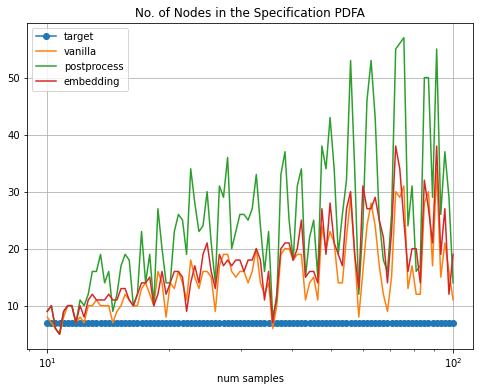

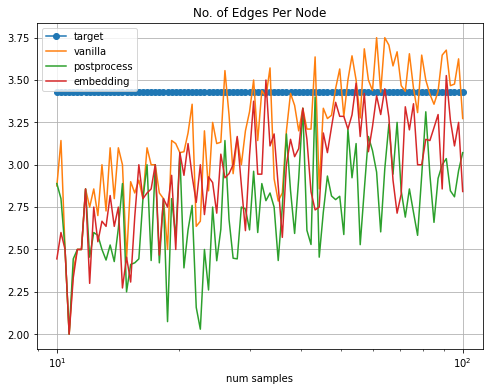

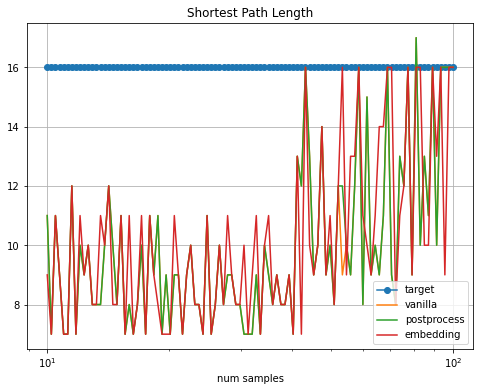

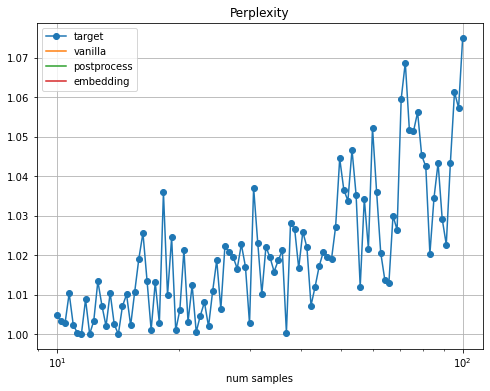

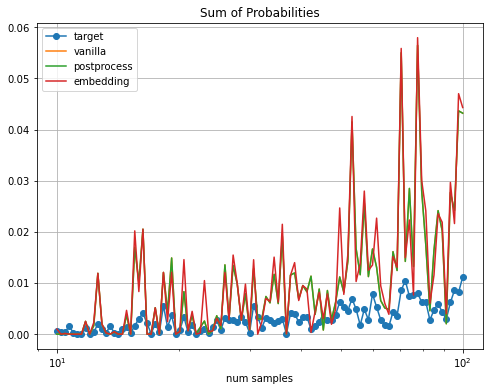

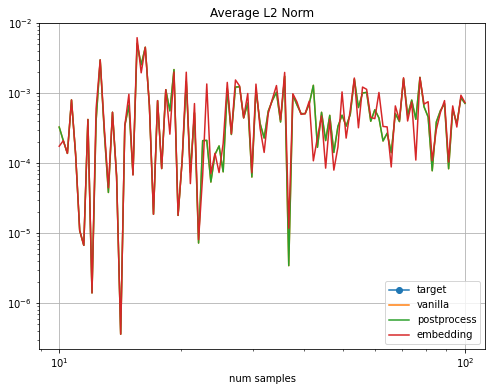

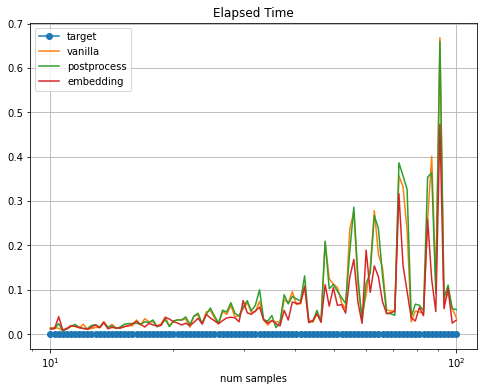

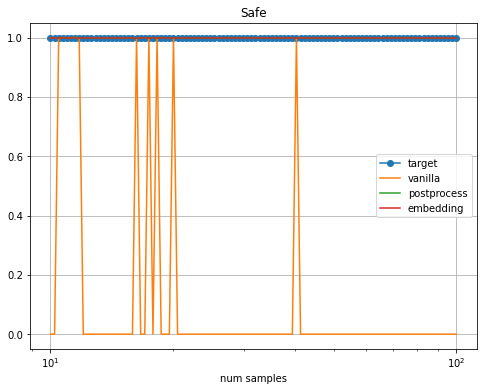

In [57]:
selected_params = {'p': '0.6'}
plot_selected_results(experiments2, params, selected_params)

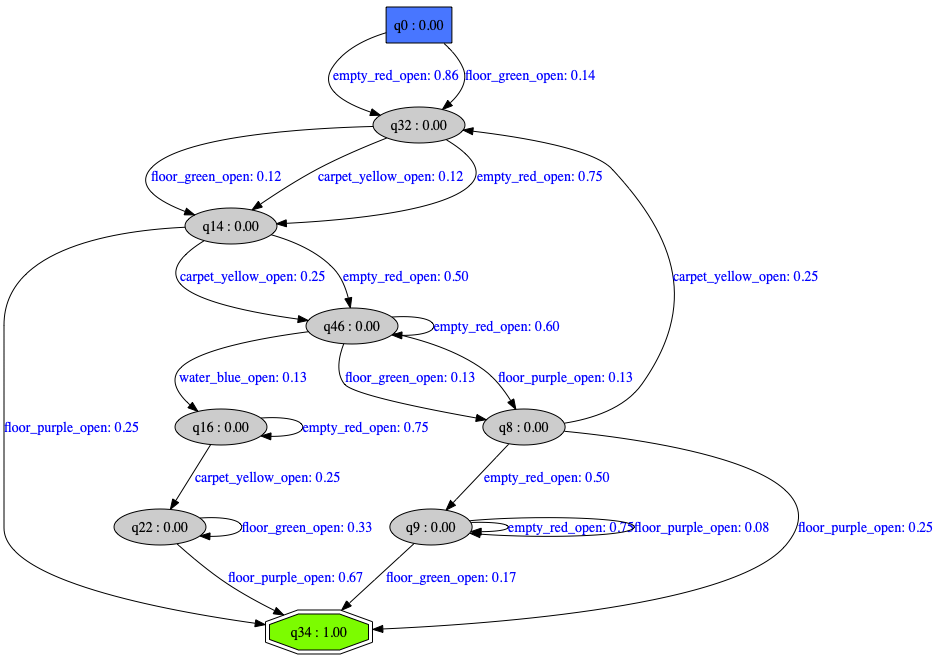

In [58]:
selected_params = {'num_samples': num_samples[0], 'p': '0.6'}
draw_selected_pdfa(experiments2, params, selected_params, pdfa_name='embedding')

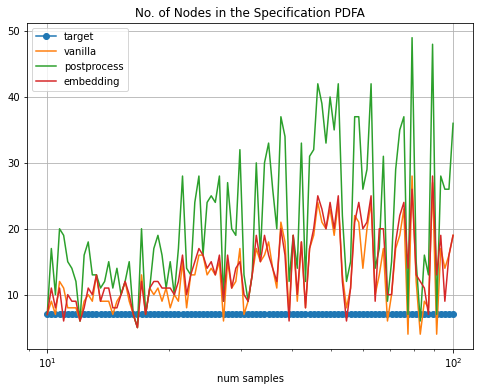

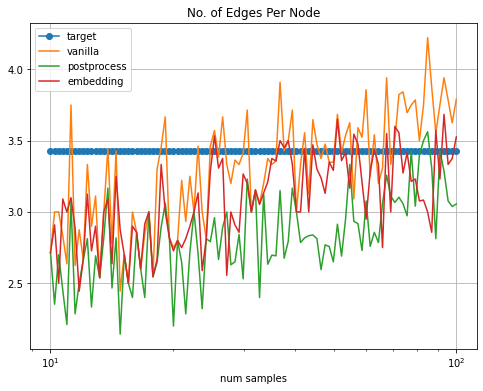

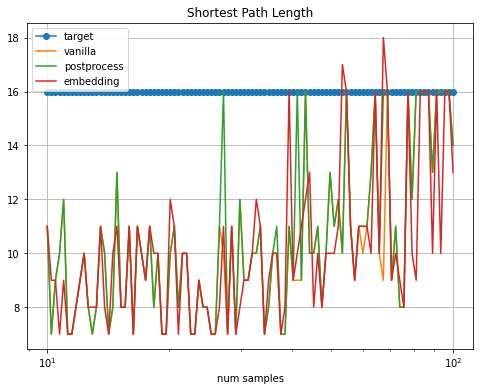

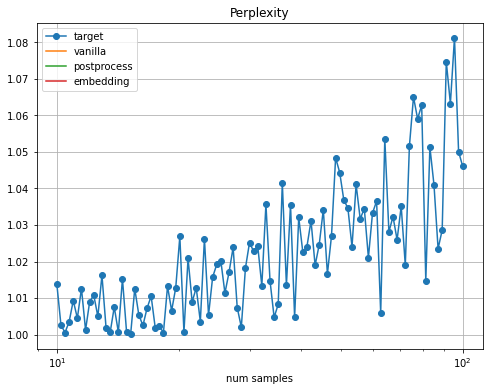

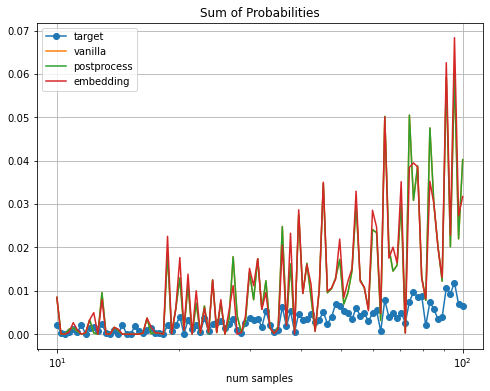

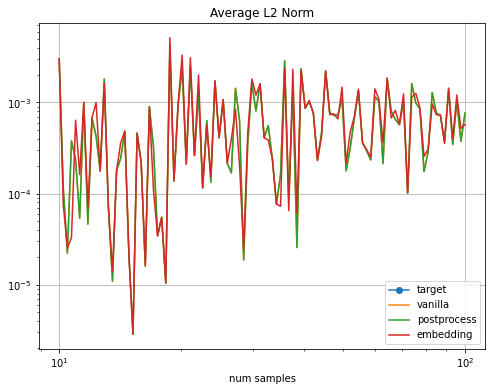

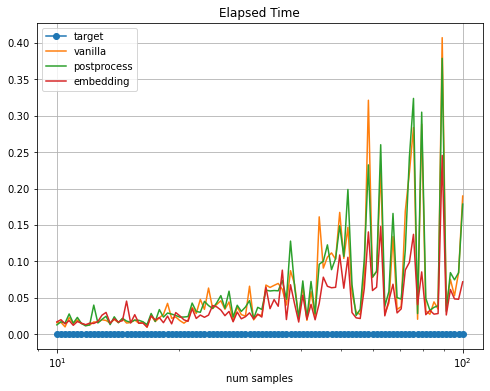

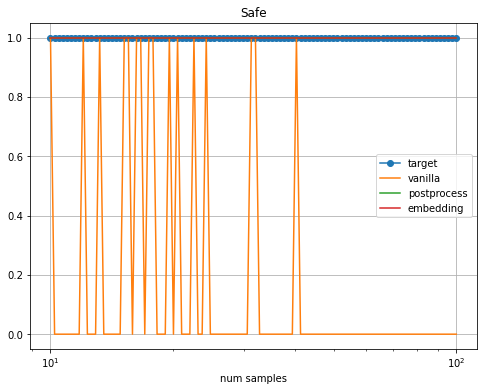

In [59]:
selected_params = {'N': '0', 'p': '1'}
plot_selected_results(experiments2, params, selected_params)

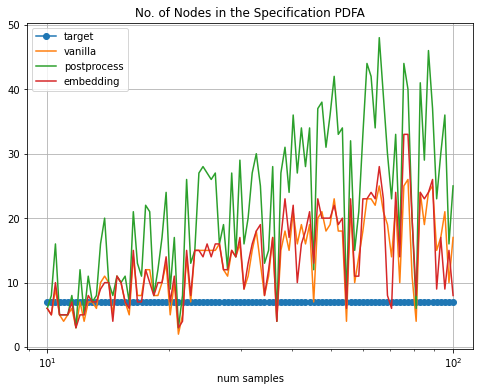

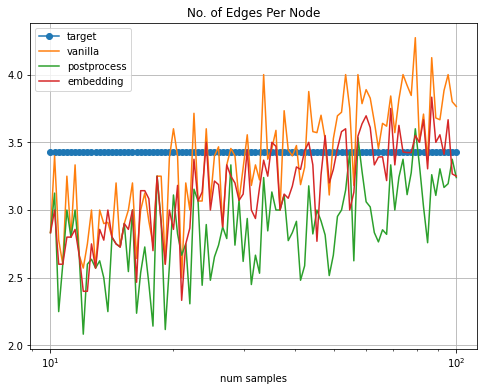

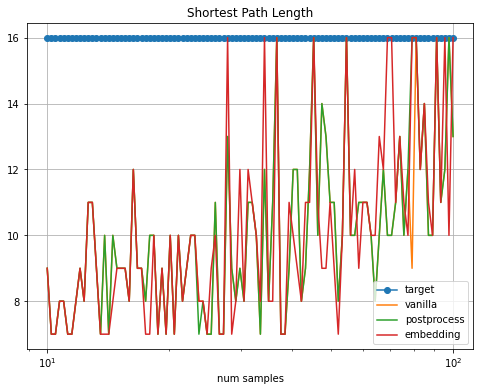

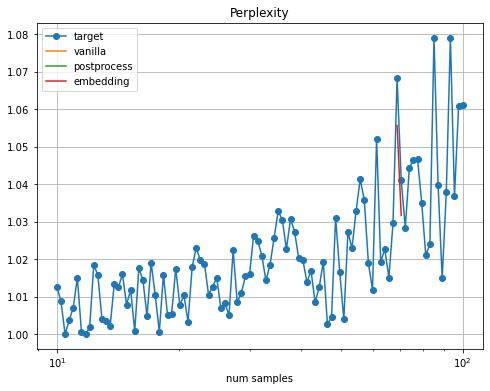

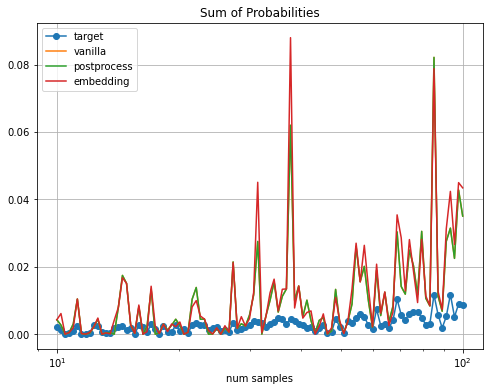

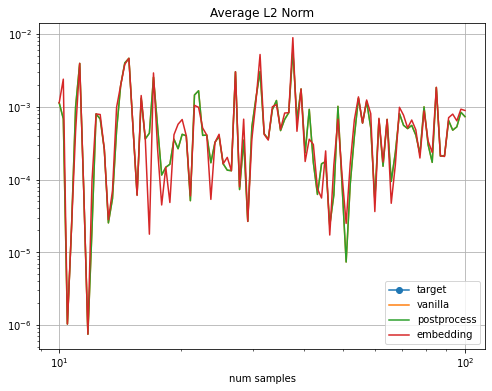

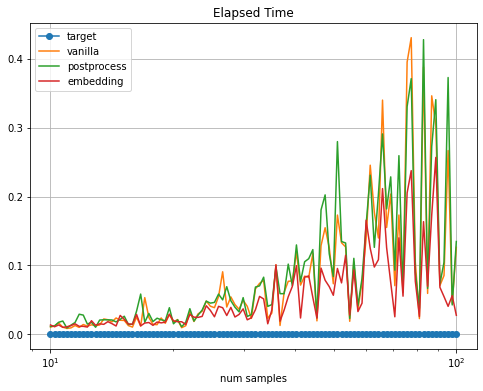

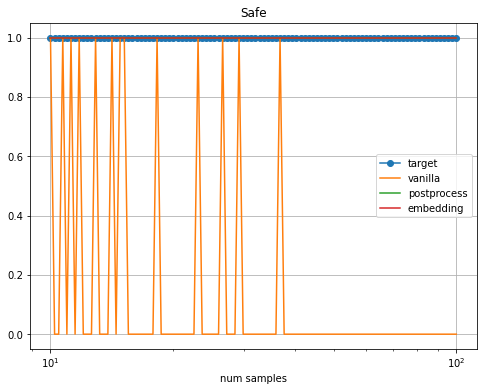

In [60]:
selected_params = {'N': '0', 'p': '2'}
plot_selected_results(experiments2, params, selected_params)

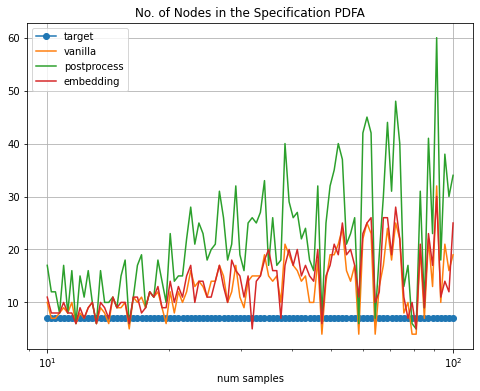

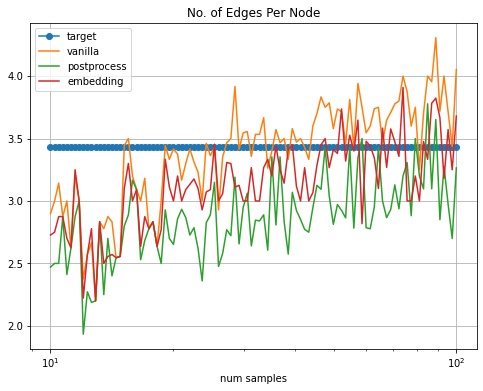

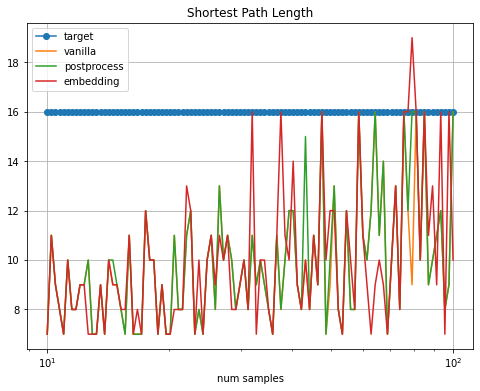

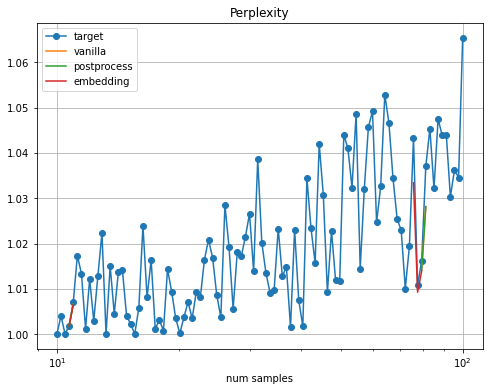

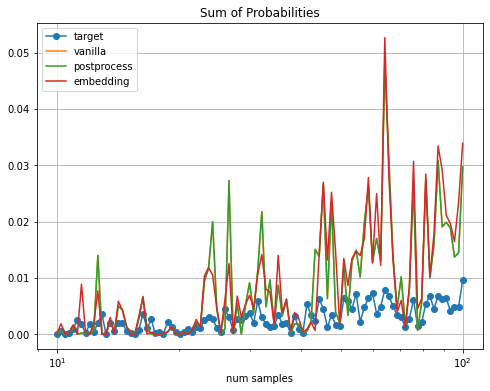

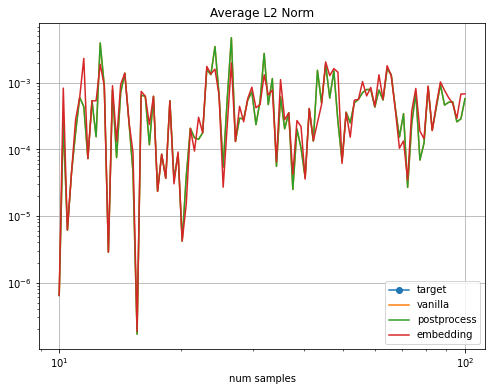

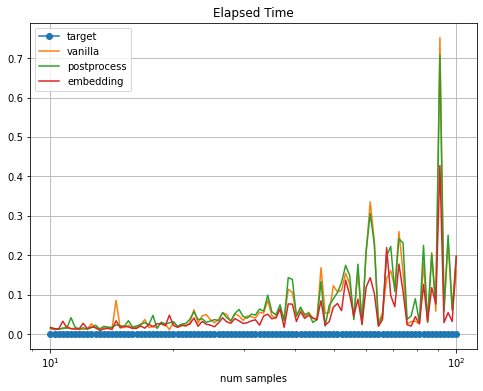

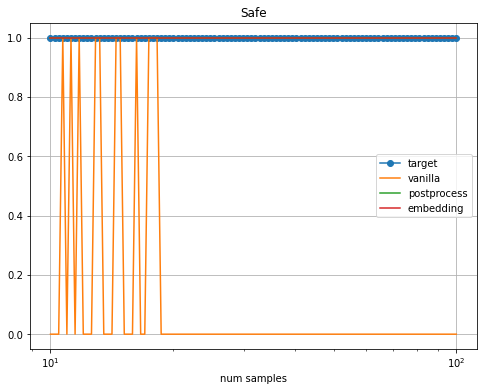

In [61]:
selected_params = {'p': '5'}
plot_selected_results(experiments2, params, selected_params)

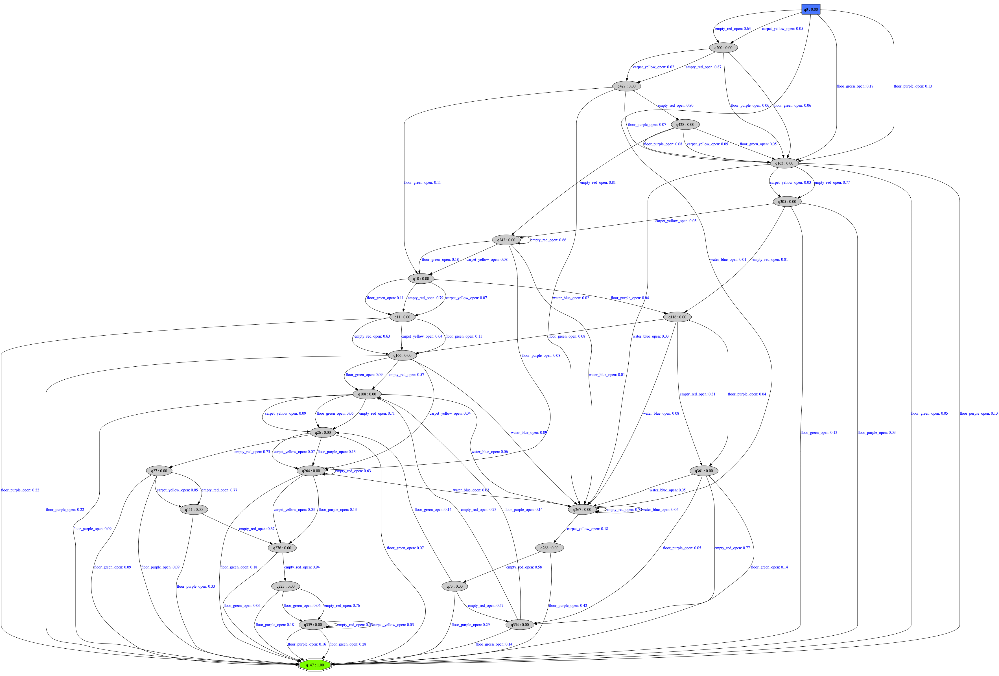

In [62]:
selected_params = {'num_samples': 100.0, 'p': '5'}
draw_selected_pdfa(experiments2, params, selected_params, pdfa_name='embedding')